In [9]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
# import scipy.stats as stats
# from scipy.stats import zscore
#from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from sklearn.model_selection import train_test_split
import itertools
import os
from datetime import datetime
#from phik.report import plot_correlation_matrix
#from patsy import dmatrices
#from statsmodels.stats.outliers_influence import variance_inflation_factor
#from featurewiz import featurewiz
#from optbinning import BinningProcess
# from sklearn.metrics import classification_report
# import openpyxl
#from pycaret.classification import *
# import re
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.metrics import accuracy_score, balanced_accuracy_score, mean_squared_error, mean_absolute_percentage_error, mean_absolute_error, r2_score
from sklearn.tree import DecisionTreeClassifier, plot_tree
# from sklearn.metrics import confusion_matrix, f1_score, roc_auc_score, precision_score, recall_score, roc_curve, auc
import pickle
# import jenkspy
# from openpyxl.drawing.image import Image
# from openpyxl import load_workbook
# from imblearn.over_sampling import SMOTE
# from collections import Counter
import random

In [10]:
pd.set_option('display.max_columns', None)
#pd.set_option('display.max_rows', None)
pd.options.display.float_format = '{:,.2f}'.format
sns.set()

In [11]:
file_path = "Dataset Bitcoin (€) da yfinance esteso da me con medie mobili da 2 a 200, 7 futuri e variazioni (periodo originale dal 17-09-2014 al 26-03-2024).csv"
df = pd.read_csv(file_path)

In [12]:
df_bitcoin = df.copy()

In [13]:
df_bitcoin

,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Futuro_1,Futuro_2,Futuro_3,Futuro_4,Futuro_5,Futuro_6,Futuro_7,Variazione futuro 1,Variazione futuro 2,Variazione futuro 3,Variazione futuro 4,Variazione futuro 5,Variazione futuro 6,Variazione futuro 7
0,231.68,232.56,228.77,231.14,231.42,231.87,231.31,230.53,230.21,229.18,229.56,229.26,229.17,228.76,228.47,229.64,230.92,231.55,232.20,232.93,233.11,235.03,237.02,238.75,240.11,241.49,242.97,244.49,245.57,246.37,246.61,246.89,247.05,247.15,247.13,247.28,247.26,246.86,246.31,245.78,244.87,243.95,243.11,242.33,241.49,240.88,240.27,239.63,238.93,238.39,237.72,237.08,236.86,236.27,235.47,234.68,233.93,233.21,232.57,232.02,231.41,230.69,230.19,229.67,229.35,228.90,228.33,227.91,227.58,227.27,227.34,227.57,227.57,227.48,227.21,226.91,226.49,225.91,225.37,224.81,224.14,223.58,223.04,222.15,221.78,221.83,221.86,221.98,222.25,222.46,222.75,222.96,223.04,223.02,223.14,223.56,223.95,224.38,224.70,225.04,225.40,225.75,226.18,226.53,226.90,227.37,227.80,228.13,228.52,228.81,229.04,229.32,229.61,230.04,230.

In [14]:
df_bitcoin.shape

(3273, 416)

In [15]:
df_bitcoin.isna().sum().sum()

0

In [16]:
# Definiamo una funzione per spostare le colonne all'inizio del dataset
def move_column_inplace(df, col, pos):
    col = df.pop(col)
    df.insert(pos, col.name, col)

In [17]:
df_bitcoin

,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Futuro_1,Futuro_2,Futuro_3,Futuro_4,Futuro_5,Futuro_6,Futuro_7,Variazione futuro 1,Variazione futuro 2,Variazione futuro 3,Variazione futuro 4,Variazione futuro 5,Variazione futuro 6,Variazione futuro 7
0,231.68,232.56,228.77,231.14,231.42,231.87,231.31,230.53,230.21,229.18,229.56,229.26,229.17,228.76,228.47,229.64,230.92,231.55,232.20,232.93,233.11,235.03,237.02,238.75,240.11,241.49,242.97,244.49,245.57,246.37,246.61,246.89,247.05,247.15,247.13,247.28,247.26,246.86,246.31,245.78,244.87,243.95,243.11,242.33,241.49,240.88,240.27,239.63,238.93,238.39,237.72,237.08,236.86,236.27,235.47,234.68,233.93,233.21,232.57,232.02,231.41,230.69,230.19,229.67,229.35,228.90,228.33,227.91,227.58,227.27,227.34,227.57,227.57,227.48,227.21,226.91,226.49,225.91,225.37,224.81,224.14,223.58,223.04,222.15,221.78,221.83,221.86,221.98,222.25,222.46,222.75,222.96,223.04,223.02,223.14,223.56,223.95,224.38,224.70,225.04,225.40,225.75,226.18,226.53,226.90,227.37,227.80,228.13,228.52,228.81,229.04,229.32,229.61,230.04,230.

In [18]:
df_bitcoin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3273 entries, 0 to 3272
Columns: 416 entries, Open to Variazione futuro 7
dtypes: float64(409), object(7)
memory usage: 10.4+ MB


### Descrizioni statistiche

In [19]:
def describex(data):
    data = pd.DataFrame(data)
    stats = data.describe(percentiles=[0.01,0.25,0.5,0.75,0.90,0.95,0.99])
    skewness = data.skew()
    kurtosis = data.kurtosis()
    skewness_df = pd.DataFrame({'skewness' : skewness}).T
    kurtosis_df = pd.DataFrame({'kurtosis' : kurtosis}).T
    mediane = data.median()
    mediane_df = pd.DataFrame({'mediane' : mediane}).T
    valori_missing = pd.DataFrame({'valori missing': data.isna().sum()}).T
    percentuale_missing = ((data.isna().sum() / len(data) * 100).round(2)).apply(lambda x: f'{x}%')
    percentuale_missing_df = pd.DataFrame({'percentuale missing': percentuale_missing}).T
    valori_unici = pd.DataFrame({'valori_unici':data.nunique()}).T
    return pd.concat([stats, kurtosis_df, skewness_df, mediane_df, valori_missing, percentuale_missing_df, valori_unici])

In [20]:
describex(df_bitcoin)

C:\Users\Alessandro\AppData\Local\Temp\ipykernel_40716\736779343.py:4: FutureWarning: The default value of numeric_only in DataFrame.skew is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  skewness = data.skew()
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_40716\736779343.py:5: FutureWarning: The default value of numeric_only in DataFrame.kurt is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  kurtosis = data.kurtosis()
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_40716\736779343.py:8: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is dep

,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Futuro_1,Futuro_2,Futuro_3,Futuro_4,Futuro_5,Futuro_6,Futuro_7,Variazione futuro 1,Variazione futuro 2,Variazione futuro 3,Variazione futuro 4,Variazione futuro 5,Variazione futuro 6,Variazione futuro 7
count,"3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273

In [21]:
# correlation_matrix = df_bitcoin.corr()

# plt.figure(figsize=(15, 20))
# sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
# plt.title('Matrice di Correlazione')
# plt.show()

In [22]:
# Analisi grafica 
def func_analisi_grafica(df, numeric_var):
    ''' Definisco la funzione per distribution plot, boxplot e Q-Q plot delle variabili numeriche '''
    plt.figure(figsize=(16,8))
    
    # Distribution plot
    plt.subplot(1,3,1)
    sns.histplot(data=df, x=df[numeric_var], element="step", stat="density")
    plt.title("Distribution plot of "+numeric_var)
       
    # Box plot
    plt.subplot(1,3,2)
    sns.boxplot(x=df[numeric_var], data=df)
    plt.title("Box plot of "+numeric_var)
    
    # Box plot
    plt.subplot(1,3,3)
    df[numeric_var].fillna(0, inplace = True)
    stats.probplot(df[numeric_var], dist="norm", plot=plt)
    plt.title("Q-Q plot of "+numeric_var)
    
    plt.show()

<h5> Analisi grafica </h5>

In [23]:
# for variable in numerical_vars:
#     func_analisi_grafica(df_bitcoin, variable)
#     print("*"*110)

<h5> Riempio eventuali colonne con valori missing </h5>

In [24]:
df_bitcoin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3273 entries, 0 to 3272
Columns: 416 entries, Open to Variazione futuro 7
dtypes: float64(409), object(7)
memory usage: 10.4+ MB


In [25]:
# conto quanti nan ci sono in ogni colonna
df_bitcoin.isna().sum()

Open                   0
High                   0
Low                    0
Close                  0
SMA_2                  0
                      ..
Variazione futuro 3    0
Variazione futuro 4    0
Variazione futuro 5    0
Variazione futuro 6    0
Variazione futuro 7    0
Length: 416, dtype: int64

In [26]:
# conto quanti nan ci sono in totale
df_bitcoin.isna().sum().sum()

0

In [27]:
def riempi_nan_con_media_e_missing(df):
    # Creo una copia del DataFrame originale perchè altrimenti mi modifica anche il dataframe originale mi pare
    df_copia = df.copy()
    
    for colonna in df_copia.columns:
        tipo_colonna = pd.api.types.infer_dtype(df_copia[colonna])
        # print(f'Tipo colonna {colonna}: {tipo_colonna}')
        if tipo_colonna in ['integer', 'floating']:
            # Per le colonne numeriche (e non bool o complex), calcolo la mediana e riempio i NaN con la mediana
            mediana_colonna = df_copia[colonna].median()
            df_copia[colonna] = df_copia[colonna].fillna(mediana_colonna)
        else:
            # Per le colonne non numeriche (inclusi però bool e complex, che qui non ci sono), riempio i NaN con "Missing"
            df_copia[colonna] = df_copia[colonna].fillna("Non Valutabile")
    return df_copia

In [28]:
df_senza_valori_nan = riempi_nan_con_media_e_missing(df_bitcoin)

In [29]:
df_senza_valori_nan.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3273 entries, 0 to 3272
Columns: 416 entries, Open to Variazione futuro 7
dtypes: float64(409), object(7)
memory usage: 10.4+ MB


In [30]:
df_senza_valori_nan.isna().sum().sum()

0

In [31]:
describex(df_senza_valori_nan)

C:\Users\Alessandro\AppData\Local\Temp\ipykernel_40716\736779343.py:4: FutureWarning: The default value of numeric_only in DataFrame.skew is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  skewness = data.skew()
C:\Users\Alessandro\AppData\Local\Temp\ipykernel_40716\736779343.py:5: FutureWarning: The default value of numeric_only in DataFrame.kurt is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  kurtosis = data.kurtosis()


C:\Users\Alessandro\AppData\Local\Temp\ipykernel_40716\736779343.py:8: FutureWarning: The default value of numeric_only in DataFrame.median is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  mediane = data.median()


,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Futuro_1,Futuro_2,Futuro_3,Futuro_4,Futuro_5,Futuro_6,Futuro_7,Variazione futuro 1,Variazione futuro 2,Variazione futuro 3,Variazione futuro 4,Variazione futuro 5,Variazione futuro 6,Variazione futuro 7
count,"3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273.00","3,273

In [32]:
df_senza_valori_nan

,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Futuro_1,Futuro_2,Futuro_3,Futuro_4,Futuro_5,Futuro_6,Futuro_7,Variazione futuro 1,Variazione futuro 2,Variazione futuro 3,Variazione futuro 4,Variazione futuro 5,Variazione futuro 6,Variazione futuro 7
0,231.68,232.56,228.77,231.14,231.42,231.87,231.31,230.53,230.21,229.18,229.56,229.26,229.17,228.76,228.47,229.64,230.92,231.55,232.20,232.93,233.11,235.03,237.02,238.75,240.11,241.49,242.97,244.49,245.57,246.37,246.61,246.89,247.05,247.15,247.13,247.28,247.26,246.86,246.31,245.78,244.87,243.95,243.11,242.33,241.49,240.88,240.27,239.63,238.93,238.39,237.72,237.08,236.86,236.27,235.47,234.68,233.93,233.21,232.57,232.02,231.41,230.69,230.19,229.67,229.35,228.90,228.33,227.91,227.58,227.27,227.34,227.57,227.57,227.48,227.21,226.91,226.49,225.91,225.37,224.81,224.14,223.58,223.04,222.15,221.78,221.83,221.86,221.98,222.25,222.46,222.75,222.96,223.04,223.02,223.14,223.56,223.95,224.38,224.70,225.04,225.40,225.75,226.18,226.53,226.90,227.37,227.80,228.13,228.52,228.81,229.04,229.32,229.61,230.04,230.

### Definizione short list da usare

In [33]:
# Conto quante colonne contengono la parola "futuro"
futuro = sum('Futuro' in column for column in df.columns)
futuro

7

In [34]:
# Questo è vero se nella rete neurale voglio usare più neuroni di output per volta
più_output = True

In [35]:
# Quando ho le features miste il numero coincide con "futuro", ma quando non sono miste parto da un dataset con tutte le colonne future e quindi devo scegliere io il numero (ad esempio ho le colonne da prezzo_futuro_1 a prezzo_futuro_7 ma potrei scegliere prezzo_futuro_5 quando non ho le features miste), quindi meglio se lo lascio scritto a mano
target_scelto = f'Futuro_1'

In [36]:
features_calcolate = [column for column in df_senza_valori_nan.columns if 'previsto' in column]
features_calcolate

[]

In [37]:
# Se ho features miste o se ho più neuroni di output devo prendere tutto il dataset che già ho
if len(features_calcolate) > 0 or più_output:
    df_short_list = df_senza_valori_nan

In [38]:
# Tolgo tutte le colonne "futuro" che non sono il target_scelto
if len(features_calcolate) == 0 and not più_output:
    df_short_list = df_senza_valori_nan.drop([f'Futuro_{c}' for c in range(1, futuro + 1) if str(c) != target_scelto.split('Futuro_')[1]], axis = 1)

In [39]:
# Tolgo la colonna Timestamp solo se non sto usando le features miste o se voglio usare più neuroni di output, perchè altrimenti non ho questa colonna nel dataset iniziale
# if len(features_calcolate) == 0:
#     df_short_list = df_short_list.drop('Timestamp', axis=1)

In [40]:
df_short_list

,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Futuro_1,Futuro_2,Futuro_3,Futuro_4,Futuro_5,Futuro_6,Futuro_7,Variazione futuro 1,Variazione futuro 2,Variazione futuro 3,Variazione futuro 4,Variazione futuro 5,Variazione futuro 6,Variazione futuro 7
0,231.68,232.56,228.77,231.14,231.42,231.87,231.31,230.53,230.21,229.18,229.56,229.26,229.17,228.76,228.47,229.64,230.92,231.55,232.20,232.93,233.11,235.03,237.02,238.75,240.11,241.49,242.97,244.49,245.57,246.37,246.61,246.89,247.05,247.15,247.13,247.28,247.26,246.86,246.31,245.78,244.87,243.95,243.11,242.33,241.49,240.88,240.27,239.63,238.93,238.39,237.72,237.08,236.86,236.27,235.47,234.68,233.93,233.21,232.57,232.02,231.41,230.69,230.19,229.67,229.35,228.90,228.33,227.91,227.58,227.27,227.34,227.57,227.57,227.48,227.21,226.91,226.49,225.91,225.37,224.81,224.14,223.58,223.04,222.15,221.78,221.83,221.86,221.98,222.25,222.46,222.75,222.96,223.04,223.02,223.14,223.56,223.95,224.38,224.70,225.04,225.40,225.75,226.18,226.53,226.90,227.37,227.80,228.13,228.52,228.81,229.04,229.32,229.61,230.04,230.

### Random forest

In [41]:
# Guardo quali sono i valori unici di ogni variabile categorica del dataset per controllare che non ce ne siano troppi per la RAM
categorical_columns = df_short_list.select_dtypes(include=['object', 'category']).columns

for col in categorical_columns:
    unique_values = df_short_list[col].unique()
    print(f"Valori unici in {col}: {unique_values}")

Valori unici in Variazione futuro 1: ['+' '-']
Valori unici in Variazione futuro 2: ['-' '+']
Valori unici in Variazione futuro 3: ['+' '-']
Valori unici in Variazione futuro 4: ['-' '+']
Valori unici in Variazione futuro 5: ['+' '-']
Valori unici in Variazione futuro 6: ['-' '+']
Valori unici in Variazione futuro 7: ['+' '-']


<h6> Converto i dati categorici in numerici con la codifica one-hot </h6>

In [42]:
# Gli alberi decisionali e le random forest possono lavorare con i dati categorici in generale, ma non è gestita da sklearn questa cosa, quindi devo farlo io
dummies = pd.get_dummies(df_short_list, drop_first=True)

In [43]:
dummies

,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Futuro_1,Futuro_2,Futuro_3,Futuro_4,Futuro_5,Futuro_6,Futuro_7,Variazione futuro 1_-,Variazione futuro 2_-,Variazione futuro 3_-,Variazione futuro 4_-,Variazione futuro 5_-,Variazione futuro 6_-,Variazione futuro 7_-
0,231.68,232.56,228.77,231.14,231.42,231.87,231.31,230.53,230.21,229.18,229.56,229.26,229.17,228.76,228.47,229.64,230.92,231.55,232.20,232.93,233.11,235.03,237.02,238.75,240.11,241.49,242.97,244.49,245.57,246.37,246.61,246.89,247.05,247.15,247.13,247.28,247.26,246.86,246.31,245.78,244.87,243.95,243.11,242.33,241.49,240.88,240.27,239.63,238.93,238.39,237.72,237.08,236.86,236.27,235.47,234.68,233.93,233.21,232.57,232.02,231.41,230.69,230.19,229.67,229.35,228.90,228.33,227.91,227.58,227.27,227.34,227.57,227.57,227.48,227.21,226.91,226.49,225.91,225.37,224.81,224.14,223.58,223.04,222.15,221.78,221.83,221.86,221.98,222.25,222.46,222.75,222.96,223.04,223.02,223.14,223.56,223.95,224.38,224.70,225.04,225.40,225.75,226.18,226.53,226.90,227.37,227.80,228.13,228.52,228.81,229.04,229.32,229.

In [44]:
if più_output:
    X = dummies.drop([f'Futuro_{c}' for c in range(1, futuro + 1)], axis=1)
    Y = dummies[[column for column in dummies.columns if 'Futuro' in column]]
else:
    X = dummies.drop(target_scelto, axis=1)
    y = dummies[target_scelto]

In [45]:
X

,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Variazione futuro 1_-,Variazione futuro 2_-,Variazione futuro 3_-,Variazione futuro 4_-,Variazione futuro 5_-,Variazione futuro 6_-,Variazione futuro 7_-
0,231.68,232.56,228.77,231.14,231.42,231.87,231.31,230.53,230.21,229.18,229.56,229.26,229.17,228.76,228.47,229.64,230.92,231.55,232.20,232.93,233.11,235.03,237.02,238.75,240.11,241.49,242.97,244.49,245.57,246.37,246.61,246.89,247.05,247.15,247.13,247.28,247.26,246.86,246.31,245.78,244.87,243.95,243.11,242.33,241.49,240.88,240.27,239.63,238.93,238.39,237.72,237.08,236.86,236.27,235.47,234.68,233.93,233.21,232.57,232.02,231.41,230.69,230.19,229.67,229.35,228.90,228.33,227.91,227.58,227.27,227.34,227.57,227.57,227.48,227.21,226.91,226.49,225.91,225.37,224.81,224.14,223.58,223.04,222.15,221.78,221.83,221.86,221.98,222.25,222.46,222.75,222.96,223.04,223.02,223.14,223.56,223.95,224.38,224.70,225.04,225.40,225.75,226.18,226.53,226.90,227.37,227.80,228.13,228.52,228.81,229.04,229.32,229.61,230.04,230.51,230.93,231.39,231.84,232.23,232.68,233.20,233.

In [46]:
if più_output:
    print(Y)
else:
    print(y)

      Futuro_1  Futuro_2  Futuro_3  Futuro_4  Futuro_5  Futuro_6  Futuro_7
0       237.04    233.69    233.99    227.25    228.50    222.67    223.12
1       233.69    233.99    227.25    228.50    222.67    223.12    222.66
2       233.99    227.25    228.50    222.67    223.12    222.66    212.46
3       227.25    228.50    222.67    223.12    222.66    212.46    205.88
4       228.50    222.67    223.12    222.66    212.46    205.88    209.68
...        ...       ...       ...       ...       ...       ...       ...
3268 63,730.01 59,975.61 62,838.26 62,122.75 56,999.38 62,092.18 60,291.38
3269 59,975.61 62,838.26 62,122.75 56,999.38 62,092.18 60,291.38 58,737.05
3270 62,838.26 62,122.75 56,999.38 62,092.18 60,291.38 58,737.05 58,998.09
3271 62,122.75 56,999.38 62,092.18 60,291.38 58,737.05 58,998.09 62,211.91
3272 56,999.38 62,092.18 60,291.38 58,737.05 58,998.09 62,211.91 64,555.20

[3273 rows x 7 columns]


<h6> Split del dataset in train, validation e test </h6>

In [47]:
# In realtà non credo di dover fare per forza lo split in ordine, posso usare anche train_test_split, ma lascio così
# Calcolo le dimensioni per la suddivisione
total_size = len(X)
train_size = int(0.8 * total_size)
val_size = int(0.1 * total_size)

# Faccio lo split in ordine
if più_output:
    X_train, Y_train = X[:train_size], Y[:train_size]
    X_val, Y_val = X[train_size:train_size+val_size], Y[train_size:train_size+val_size]
    X_test, Y_test = X[train_size+val_size:], Y[train_size+val_size:]
else:
    X_train, y_train = X[:train_size], y[:train_size]
    X_val, y_val = X[train_size:train_size+val_size], y[train_size:train_size+val_size]
    X_test, y_test = X[train_size+val_size:], y[train_size+val_size:]

In [48]:
X_train

,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Variazione futuro 1_-,Variazione futuro 2_-,Variazione futuro 3_-,Variazione futuro 4_-,Variazione futuro 5_-,Variazione futuro 6_-,Variazione futuro 7_-
0,231.68,232.56,228.77,231.14,231.42,231.87,231.31,230.53,230.21,229.18,229.56,229.26,229.17,228.76,228.47,229.64,230.92,231.55,232.20,232.93,233.11,235.03,237.02,238.75,240.11,241.49,242.97,244.49,245.57,246.37,246.61,246.89,247.05,247.15,247.13,247.28,247.26,246.86,246.31,245.78,244.87,243.95,243.11,242.33,241.49,240.88,240.27,239.63,238.93,238.39,237.72,237.08,236.86,236.27,235.47,234.68,233.93,233.21,232.57,232.02,231.41,230.69,230.19,229.67,229.35,228.90,228.33,227.91,227.58,227.27,227.34,227.57,227.57,227.48,227.21,226.91,226.49,225.91,225.37,224.81,224.14,223.58,223.04,222.15,221.78,221.83,221.86,221.98,222.25,222.46,222.75,222.96,223.04,223.02,223.14,223.56,223.95,224.38,224.70,225.04,225.40,225.75,226.18,226.53,226.90,227.37,227.80,228.13,228.52,228.81,229.04,229.32,229.61,230.04,230.51,230.93,231.39,231.84,232.23,232.68,233.20,233.

In [49]:
if più_output:
    print(Y_train)
else:
    print(y_train)

      Futuro_1  Futuro_2  Futuro_3  Futuro_4  Futuro_5  Futuro_6  Futuro_7
0       237.04    233.69    233.99    227.25    228.50    222.67    223.12
1       233.69    233.99    227.25    228.50    222.67    223.12    222.66
2       233.99    227.25    228.50    222.67    223.12    222.66    212.46
3       227.25    228.50    222.67    223.12    222.66    212.46    205.88
4       228.50    222.67    223.12    222.66    212.46    205.88    209.68
...        ...       ...       ...       ...       ...       ...       ...
2613 29,616.63 27,979.70 28,337.81 27,708.94 27,831.81 27,881.74 29,346.38
2614 27,979.70 28,337.81 27,708.94 27,831.81 27,881.74 29,346.38 29,123.80
2615 28,337.81 27,708.94 27,831.81 27,881.74 29,346.38 29,123.80 28,192.89
2616 27,708.94 27,831.81 27,881.74 29,346.38 29,123.80 28,192.89 28,356.05
2617 27,831.81 27,881.74 29,346.38 29,123.80 28,192.89 28,356.05 27,648.17

[2618 rows x 7 columns]


In [50]:
X_val

,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Variazione futuro 1_-,Variazione futuro 2_-,Variazione futuro 3_-,Variazione futuro 4_-,Variazione futuro 5_-,Variazione futuro 6_-,Variazione futuro 7_-
2618,"27,710.57","27,922.91","27,518.29","27,831.81","27,770.38","27,959.52","27,964.56","28,294.98","28,487.24","28,338.10","28,151.99","27,987.83","27,915.92","27,892.84","27,870.98","27,822.18","27,884.22","27,882.37","27,867.05","27,913.28","27,886.03","27,936.37","27,969.89","28,071.61","28,109.74","28,110.39","28,105.31","28,082.18","28,135.32","28,155.53","28,304.91","28,489.45","28,678.72","28,873.02","29,138.78","29,342.63","29,557.85","29,756.65","29,923.69","30,104.64","30,308.90","30,485.10","30,618.34","30,792.66","30,928.87","31,060.92","31,192.30","31,330.37","31,478.27","31,626.48","31,756.56","31,858.04","31,968.65","32,077.27","32,170.05","32,275.98","32,364.67","32,436.86","32,550.11","32,669.13","32,776.21","32,899.34","33,011.81","33,155.42","33,305.82","33,444.69","33,571.01","33,698.99","33,811.50","33,936.20","34,066.

In [51]:
if più_output:
    print(Y_val)
else:
    print(y_val)

      Futuro_1  Futuro_2  Futuro_3  Futuro_4  Futuro_5  Futuro_6  Futuro_7
2618 27,881.74 29,346.38 29,123.80 28,192.89 28,356.05 27,648.17 26,958.94
2619 29,346.38 29,123.80 28,192.89 28,356.05 27,648.17 26,958.94 25,513.98
2620 29,123.80 28,192.89 28,356.05 27,648.17 26,958.94 25,513.98 21,592.95
2621 28,192.89 28,356.05 27,648.17 26,958.94 25,513.98 21,592.95 21,274.75
2622 28,356.05 27,648.17 26,958.94 25,513.98 21,592.95 21,274.75 21,586.84
...        ...       ...       ...       ...       ...       ...       ...
2940 25,068.71 25,101.65 24,893.01 25,785.67 25,732.86 26,717.72 26,368.09
2941 25,101.65 24,893.01 25,785.67 25,732.86 26,717.72 26,368.09 26,284.86
2942 24,893.01 25,785.67 25,732.86 26,717.72 26,368.09 26,284.86 26,581.58
2943 25,785.67 25,732.86 26,717.72 26,368.09 26,284.86 26,581.58 25,610.46
2944 25,732.86 26,717.72 26,368.09 26,284.86 26,581.58 25,610.46 26,047.43

[327 rows x 7 columns]


In [52]:
X_test

,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Variazione futuro 1_-,Variazione futuro 2_-,Variazione futuro 3_-,Variazione futuro 4_-,Variazione futuro 5_-,Variazione futuro 6_-,Variazione futuro 7_-
2945,"25,778.81","27,323.03","24,760.71","25,732.86","25,759.27","25,470.51","25,378.30","25,316.38","25,193.91","25,273.79","25,404.27","25,659.00","25,788.38","25,952.91","26,065.82","26,172.75","26,267.95","26,343.80","26,428.38","26,478.49","26,449.82","26,395.61","26,345.62","26,314.01","26,292.64","26,267.15","26,234.35","26,229.11","26,225.80","26,225.04","26,206.58","26,204.46","26,169.54","26,135.52","26,130.48","26,111.79","26,094.16","26,095.78","26,068.79","26,071.09","26,066.72","26,071.46","26,045.31","26,032.14","25,974.34","25,906.00","25,841.54","25,768.75","25,659.64","25,526.02","25,388.89","25,263.31","25,142.76","25,053.44","24,976.74","24,901.49","24,831.36","24,761.80","24,694.89","24,650.24","24,607.38","24,561.25","24,521.42","24,485.42","24,444.05","24,403.93","24,375.70","24,351.58","24,330.22","24,313.99","24,291.

In [53]:
if più_output:
    print(Y_test)
else:
    print(y_test)

      Futuro_1  Futuro_2  Futuro_3  Futuro_4  Futuro_5  Futuro_6  Futuro_7
2945 26,717.72 26,368.09 26,284.86 26,581.58 25,610.46 26,047.43 26,205.54
2946 26,368.09 26,284.86 26,581.58 25,610.46 26,047.43 26,205.54 26,170.33
2947 26,284.86 26,581.58 25,610.46 26,047.43 26,205.54 26,170.33 26,344.97
2948 26,581.58 25,610.46 26,047.43 26,205.54 26,170.33 26,344.97 25,783.21
2949 25,610.46 26,047.43 26,205.54 26,170.33 26,344.97 25,783.21 25,825.05
...        ...       ...       ...       ...       ...       ...       ...
3268 63,730.01 59,975.61 62,838.26 62,122.75 56,999.38 62,092.18 60,291.38
3269 59,975.61 62,838.26 62,122.75 56,999.38 62,092.18 60,291.38 58,737.05
3270 62,838.26 62,122.75 56,999.38 62,092.18 60,291.38 58,737.05 58,998.09
3271 62,122.75 56,999.38 62,092.18 60,291.38 58,737.05 58,998.09 62,211.91
3272 56,999.38 62,092.18 60,291.38 58,737.05 58,998.09 62,211.91 64,555.20

[328 rows x 7 columns]


In [54]:
describex(X_train)

,Open,High,Low,Close,SMA_2,SMA_3,SMA_4,SMA_5,SMA_6,SMA_7,SMA_8,SMA_9,SMA_10,SMA_11,SMA_12,SMA_13,SMA_14,SMA_15,SMA_16,SMA_17,SMA_18,SMA_19,SMA_20,SMA_21,SMA_22,SMA_23,SMA_24,SMA_25,SMA_26,SMA_27,SMA_28,SMA_29,SMA_30,SMA_31,SMA_32,SMA_33,SMA_34,SMA_35,SMA_36,SMA_37,SMA_38,SMA_39,SMA_40,SMA_41,SMA_42,SMA_43,SMA_44,SMA_45,SMA_46,SMA_47,SMA_48,SMA_49,SMA_50,SMA_51,SMA_52,SMA_53,SMA_54,SMA_55,SMA_56,SMA_57,SMA_58,SMA_59,SMA_60,SMA_61,SMA_62,SMA_63,SMA_64,SMA_65,SMA_66,SMA_67,SMA_68,SMA_69,SMA_70,SMA_71,SMA_72,SMA_73,SMA_74,SMA_75,SMA_76,SMA_77,SMA_78,SMA_79,SMA_80,SMA_81,SMA_82,SMA_83,SMA_84,SMA_85,SMA_86,SMA_87,SMA_88,SMA_89,SMA_90,SMA_91,SMA_92,SMA_93,SMA_94,SMA_95,SMA_96,SMA_97,SMA_98,SMA_99,SMA_100,SMA_101,SMA_102,SMA_103,SMA_104,SMA_105,SMA_106,SMA_107,SMA_108,SMA_109,SMA_110,SMA_111,SMA_112,SMA_113,SMA_114,SMA_115,SMA_116,SMA_117,SMA_118,SMA_119,SMA_120,SMA_121,SMA_122,SMA_123,SMA_124,SMA_125,SMA_126,SMA_127,SMA_128,SMA_129,SMA_130,SMA_131,SMA_132,SMA_133,SMA_134,SMA_135,SMA_136,SMA_137,SMA_138,SMA_139,SMA_140,SMA_141,SMA_142,SMA_143,SMA_144,SMA_145,SMA_146,SMA_147,SMA_148,SMA_149,SMA_150,SMA_151,SMA_152,SMA_153,SMA_154,SMA_155,SMA_156,SMA_157,SMA_158,SMA_159,SMA_160,SMA_161,SMA_162,SMA_163,SMA_164,SMA_165,SMA_166,SMA_167,SMA_168,SMA_169,SMA_170,SMA_171,SMA_172,SMA_173,SMA_174,SMA_175,SMA_176,SMA_177,SMA_178,SMA_179,SMA_180,SMA_181,SMA_182,SMA_183,SMA_184,SMA_185,SMA_186,SMA_187,SMA_188,SMA_189,SMA_190,SMA_191,SMA_192,SMA_193,SMA_194,SMA_195,SMA_196,SMA_197,SMA_198,SMA_199,SMA_200,EMA_2,EMA_3,EMA_4,EMA_5,EMA_6,EMA_7,EMA_8,EMA_9,EMA_10,EMA_11,EMA_12,EMA_13,EMA_14,EMA_15,EMA_16,EMA_17,EMA_18,EMA_19,EMA_20,EMA_21,EMA_22,EMA_23,EMA_24,EMA_25,EMA_26,EMA_27,EMA_28,EMA_29,EMA_30,EMA_31,EMA_32,EMA_33,EMA_34,EMA_35,EMA_36,EMA_37,EMA_38,EMA_39,EMA_40,EMA_41,EMA_42,EMA_43,EMA_44,EMA_45,EMA_46,EMA_47,EMA_48,EMA_49,EMA_50,EMA_51,EMA_52,EMA_53,EMA_54,EMA_55,EMA_56,EMA_57,EMA_58,EMA_59,EMA_60,EMA_61,EMA_62,EMA_63,EMA_64,EMA_65,EMA_66,EMA_67,EMA_68,EMA_69,EMA_70,EMA_71,EMA_72,EMA_73,EMA_74,EMA_75,EMA_76,EMA_77,EMA_78,EMA_79,EMA_80,EMA_81,EMA_82,EMA_83,EMA_84,EMA_85,EMA_86,EMA_87,EMA_88,EMA_89,EMA_90,EMA_91,EMA_92,EMA_93,EMA_94,EMA_95,EMA_96,EMA_97,EMA_98,EMA_99,EMA_100,EMA_101,EMA_102,EMA_103,EMA_104,EMA_105,EMA_106,EMA_107,EMA_108,EMA_109,EMA_110,EMA_111,EMA_112,EMA_113,EMA_114,EMA_115,EMA_116,EMA_117,EMA_118,EMA_119,EMA_120,EMA_121,EMA_122,EMA_123,EMA_124,EMA_125,EMA_126,EMA_127,EMA_128,EMA_129,EMA_130,EMA_131,EMA_132,EMA_133,EMA_134,EMA_135,EMA_136,EMA_137,EMA_138,EMA_139,EMA_140,EMA_141,EMA_142,EMA_143,EMA_144,EMA_145,EMA_146,EMA_147,EMA_148,EMA_149,EMA_150,EMA_151,EMA_152,EMA_153,EMA_154,EMA_155,EMA_156,EMA_157,EMA_158,EMA_159,EMA_160,EMA_161,EMA_162,EMA_163,EMA_164,EMA_165,EMA_166,EMA_167,EMA_168,EMA_169,EMA_170,EMA_171,EMA_172,EMA_173,EMA_174,EMA_175,EMA_176,EMA_177,EMA_178,EMA_179,EMA_180,EMA_181,EMA_182,EMA_183,EMA_184,EMA_185,EMA_186,EMA_187,EMA_188,EMA_189,EMA_190,EMA_191,EMA_192,EMA_193,EMA_194,EMA_195,EMA_196,EMA_197,EMA_198,EMA_199,EMA_200,Variazione futuro 1_-,Variazione futuro 2_-,Variazione futuro 3_-,Variazione futuro 4_-,Variazione futuro 5_-,Variazione futuro 6_-,Variazione futuro 7_-
count,"2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00","2,618.00",

<h6> Random forest con 1 sola combinazione scelta da me </h6>

In [55]:
help(RandomForestRegressor)

Help on class RandomForestRegressor in module sklearn.ensemble._forest:

class RandomForestRegressor(ForestRegressor)
 |  RandomForestRegressor(n_estimators=100, *, criterion='squared_error', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features=1.0, max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, ccp_alpha=0.0, max_samples=None)
 |  
 |  A random forest regressor.
 |  
 |  A random forest is a meta estimator that fits a number of classifying
 |  decision trees on various sub-samples of the dataset and uses averaging
 |  to improve the predictive accuracy and control over-fitting.
 |  The sub-sample size is controlled with the `max_samples` parameter if
 |  `bootstrap=True` (default), otherwise the whole dataset is used to build
 |  each tree.
 |  
 |  Read more in the :ref:`User Guide <forest>`.
 |  
 |  Parameters
 |  ----------
 |  n_estimators 

In [56]:
# Inizializzazione del modello come regressore random forest
regressor = RandomForestRegressor(
    n_estimators=100,
    max_depth=10,
    min_samples_split=2,
    min_samples_leaf=1,
    max_features=None,
    random_state=42,
    bootstrap=True,
    verbose=1
)

In [57]:
# Alleno il modello
if più_output:
    regressor.fit(X_train, Y_train)
else:
    regressor.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:  2.2min finished


In [58]:
if più_output:
    Y_pred = regressor.predict(X_test)
else:
    y_pred = regressor.predict(X_test)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    0.0s finished


In [59]:
# Calcolo dell'errore quadratico medio (MSE) come metrica di valutazione
if più_output:
    mse = mean_squared_error(Y_test, Y_pred)
    print(mse)
else:
    mse = mean_squared_error(y_test, y_pred)
    print(mse)

22044134.528297644


In [60]:
# Calcolo del Mean Absolute Percentage Error (MAPE)
if più_output:
    mape = mean_absolute_percentage_error(Y_test, Y_pred)
    print(mape)
else:
    mape = mean_absolute_percentage_error(y_test, y_pred)
    print(mape)

0.13036424929222537


In [61]:
# Calcolo del Mean Absolute Error (MAE)
if più_output:
    mae = mean_absolute_error(Y_test, Y_pred)
    print(mae)
else:
    mae = mean_absolute_error(y_test, y_pred)
    print(mae)

4007.139231868685


<h6> Grid search con tecnica SMOTE (X_res e y_res anzichè X_train e y_train) e zoom automatizzato </h6>

In [62]:
# # Parametri della griglia
# param_grid = {
#     'n_estimators': [300, 500, 700],
#     'criterion': ['gini'],
#     'max_depth': [35, 50, 70],
#     'min_samples_split': [2],
#     'min_samples_leaf': [1],
#     'min_weight_fraction_leaf':[0.0],
#     'max_features': [0.25, 0.5, 0.75],
#     'max_leaf_nodes': [None],
#     'min_impurity_decrease': [0.0],
#     'bootstrap': [True, False],
#     'oob_score': [False],
#     'n_jobs': [None],
#     'random_state': [0, 8],
#     'verbose': [0],
#     'warm_start': [False],
#     'class_weight': [None],
#     'ccp_alpha': [0.0],
#     'max_samples': [None],
# }

# metrica_scelta = 'media pesata delle metriche' # deve fare parte dell'elenco ['Accuracy', 'Recall', 'F1', 'Balanced accuracy', 'Precision', 'AUC', 'Media', 'Media pesata']

# soglia_metrica = 0.01 # Di quanto deve migliorare come minimo la metrica_scelta affinchè lo zoom continui, altrimenti si ferma

# # Mi creo una lista di pesi per la media pesata, quindi un peso per ogni metrica
# pesi_media_pesata = {
#     'accuracy': 1,
#     'recall': 5,
#     'f1': 1,
#     'balanced_accuracy': 3,
#     'precision': 1,
#     'AUC': 2
# }

# seed_value_train_test_split = 42
# test_size_train_test_split = 0.1
# validation_size_train_test_split = 0.09
# # Split in train, validation e test
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = test_size_train_test_split, random_state = seed_value_train_test_split) 
# X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size = validation_size_train_test_split / (1 - test_size_train_test_split), random_state = seed_value_train_test_split)


# seed_value_smote = 42
# k_neighbors = 5
# # Da usare solo per popolare la classe minoritaria (se sampling_strategy='minority') fino alla dimensione della classe maggioritaria
# sm = SMOTE(sampling_strategy='minority', k_neighbors=k_neighbors, random_state=seed_value_smote)
# X_res, y_res = sm.fit_resample(X_train, y_train)

# class_counts = Counter(y_res)
# counter_sin = {cls: Counter(y_res)[cls] - Counter(y_train)[cls] for cls in class_counts.keys()}

# # Aggiorna il tuo codice principale per chiamare la nuova funzione
# perform_grid_search_and_zoom(X_res, y_res, param_grid, metrica_scelta, soglia_metrica, pesi_media_pesata, counter_sin)

In [63]:
# # Aggiungi questa funzione al tuo codice
# def perform_grid_search_and_zoom(X, y, param_grid, metrica_scelta, soglia_metrica, pesi_media_pesata, counter_sin):
#     # ... il tuo codice esistente ...

#     # Parametri di eccezione
#     eccezioni = ['random_state']

#     # Inizializza le variabili
#     best_metric_value = 0
#     best_params = None
#     zooming = True

#     while zooming:
#         for key, values in param_grid.items():
#             # Trova il miglior valore per il parametro corrente
#             best_value = find_best_value(X, y, key, values, metrica_scelta)

#             # Aggiorna il parametro nella griglia
#             if key not in eccezioni:
#                 param_grid[key] = generate_new_values(best_value, values)

#         # Esegui la grid search
#         result = run_grid_search(X, y, param_grid, pesi_media_pesata, counter_sin)

#         # Calcola la metrica scelta
#         current_metric_value = result[metrica_scelta]

#         # Confronta con il miglior valore precedente
#         if current_metric_value > best_metric_value:
#             best_metric_value = current_metric_value
#             best_params = result['params']
#         else:
#             zooming = False

#             # Visualizza i risultati della grid search
#             print(f"Risultati della grid search per '{metrica_scelta}': {best_metric_value}")
#             print(f"Parametri ottimali: {best_params}")

#     # ... continua con il tuo codice esistente ...

In [64]:
# # Aggiungi questa funzione al tuo codice
# def find_best_value(X, y, key, values, metrica_scelta):
#     best_value = None
#     best_metric_value = 0

#     for value in values:
#         # Genera nuovi parametri con il valore corrente
#         param_grid[key] = [value]
#         result = run_grid_search(X, y, param_grid, pesi_media_pesata)
#         current_metric_value = result[metrica_scelta]

#         # Aggiorna se la metrica è migliore
#         if current_metric_value > best_metric_value:
#             best_metric_value = current_metric_value
#             best_value = value

#     return best_value

In [65]:
# # Aggiungi questa funzione al tuo codice
# def generate_new_values(best_value, values):
#     if len(values) == 1 or len(values) == 2:
#         return values
#     elif best_value == max(values):
#         return [np.mean(values[1:2]), max(values), max(values) + np.mean(values[1:2])]
#     elif best_value == min(values):
#         new_value = best_value - np.mean(values[1:2])
#         return [new_value if new_value >= 0 else 1 if isinstance(new_value, int) else np.mean(values)/2] + values[1:2] + [np.mean(values[1:2]) + best_value]
#     else:
#         return [np.mean([best_value, values[values.index(best_value) - 1]]), best_value, np.mean([best_value, values[values.index(best_value) + 1]])]

In [66]:
# def run_grid_search(X, y, param_grid, pesi_media_pesata, counter_sin):
#     # Creo una nuova cartella per salvare i modelli, con un nuovo nome se la cartella esiste già
#     current_time = datetime.now().strftime("%d-%m-%Y_%H-%M-%S")
#     model_dir = 'Modelli'
#     counter = 1

#     # Elenco di tutte le directory nella directory corrente
#     existing_dirs = os.listdir()

#     while any(name.startswith(f"{counter} - Modelli") for name in existing_dirs):
#         counter += 1

#     # In realtà qui mi serve counter_sin che definisco successivamente, ma non potendolo spostare sotto lascio che venga usato il valore preso dalle celle precedenti (qui, affinchè il titolo della cartella sia corretto, devo assicurarmi che il seed_value_train_test_split usato nelle celle precedenti sia lo stesso messo nella grid search, perchè quello determina poi il numero di dati sintetici generati, che si vede in counter_sin)
#     new_dir = f'{counter} - {model_dir} {current_time} (standard+_SMOTE_sin{counter_sin[0] + counter_sin[1]}_Target_Stopp)'

#     os.makedirs(new_dir)

#     # Creo un txt in cui salvare le stampe a video (in questo caso ne creo uno vuoto)
#     txt_output = os.path.join(new_dir, f'prints {counter}.txt')
#     with open(txt_output, 'w'):
#         pass

#     print(f'Grid search numero {counter}\n')
#     # Salvo la stessa stampa nel txt di output
#     with open(txt_output, 'a', encoding='utf-8') as file:
#         print(f'Grid search numero {counter}\n', file=file)

#     print(f'Short list usata:\n{colonne_da_usare}\n')
#     # Salvo la stessa stampa nel txt di output
#     with open(txt_output, 'a', encoding='utf-8') as file:
#         print(f'Short list usata:\n{colonne_da_usare}\n', file=file)

#     print(f'Grid search usata:\n{param_grid}\n')
#     # Salvo la stessa stampa nel txt di output
#     with open(txt_output, 'a', encoding='utf-8') as file:
#         print(f'Grid search usata:\n{param_grid}\n', file=file)

#     print(f'Pesi scelti per la media pesata:\n{pesi_media_pesata}\n')
#     # Salvo la stessa stampa nel txt di output
#     with open(txt_output, 'a', encoding='utf-8') as file:
#         print(f'Pesi scelti per la media pesata:\n{pesi_media_pesata}\n', file=file)


#     # Creo nella cartella appena creata una nuova cartella per ogni metrica che voglio monitorare
#     dir_accuracy = os.path.join(new_dir, 'Accuracy')
#     dir_recall = os.path.join(new_dir, 'Recall')
#     dir_f1 = os.path.join(new_dir, 'F1')
#     dir_balanced_accuracy = os.path.join(new_dir, 'Balanced accuracy')
#     dir_precision = os.path.join(new_dir, 'Precision')
#     dir_AUC = os.path.join(new_dir, 'AUC')
#     dir_media = os.path.join(new_dir, 'Media')
#     dir_media_pesata = os.path.join(new_dir, 'Media pesata')

#     dirs_monitoraggio = [dir_accuracy, dir_recall, dir_f1, dir_balanced_accuracy, dir_precision, dir_AUC, dir_media, dir_media_pesata]

#     for dir in dirs_monitoraggio:
#         os.makedirs(dir)


#     # Mi creo delle variabili fittizie solo perchè altrimenti nella lista successiva non sa cosa siano queste variabili (lo 0 può essere in realtà qualunque valore, tanto vengono sovrascritti subito dopo il primo fit)
#     accuracy_val = 0
#     recall_val = 0
#     f1_val = 0
#     bas_val = 0
#     precision_val = 0
#     AUC_val = 0
#     media_val = 0
#     media_pesata_val = 0

#     # Inizializzo a 0 i valori massimi di ogni variabile che voglio monitorare
#     variabili_da_monitorare_val = [accuracy_val, recall_val, f1_val, bas_val, precision_val, AUC_val, media_val, media_pesata_val]
#     max_variabili_da_monitorare_val = [0]*len(variabili_da_monitorare_val)
#     modelli_migliori = ['']*len(variabili_da_monitorare_val)
#     nomi_variabili = ['accuracy', 'recall', 'f1', 'balanced accuracy', 'precision', 'AUC', 'media delle metriche', 'media pesata delle metriche']

#     # Itera su tutte le combinazioni dei parametri
#     all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]
#     # all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())][::-1]

#     # for i in range(1464 - 1, -1, -1):
#     #     params = all_params[len(all_params) - i - 1]
#     for i, params in enumerate(all_params):
#         # if i+1 >= 119:

#             n_estimators, criterion, max_depth, min_samples_split, min_samples_leaf, min_weight_fraction_leaf, max_features, max_leaf_nodes, min_impurity_decrease, bootstrap, oob_score, n_jobs, random_state, verbose, warm_start, class_weight, ccp_alpha, max_samples, seed_value_train_test_split, seed_value_smote, k_neighbors = params.values()

#             print(f'Semi usati per la riproducibilità:\nseed_value_train_test_split: {seed_value_train_test_split}\nseed_value_smote: {seed_value_smote}\nrandom_state usato nella grid search: {random_state}\n')
#             # Salvo la stessa stampa nel txt di output
#             with open(txt_output, 'a', encoding='utf-8') as file:
#                 print(f'Semi usati per la riproducibilità:\nseed_value_train_test_split: {seed_value_train_test_split}\nseed_value_smote: {seed_value_smote}\nrandom_state usato nella grid search: {random_state}\n\n', file=file)

#             print(f'k_neighbors scelti per lo SMOTE: {k_neighbors}\n')
#             with open(txt_output, 'a', encoding='utf-8') as file:
#                 print(f'k_neighbors scelti per lo SMOTE: {k_neighbors}\n', file=file)

#             # Inizializzo il modello come un classificatore random forest
#             clf = RandomForestClassifier(
#             n_estimators=n_estimators,  # Numero di alberi nella foresta
#             criterion=criterion,  # Il criterio utilizzato per misurare la qualità delle divisioni
#             max_depth=max_depth,  # Profondità massima degli alberi
#             min_samples_split=min_samples_split,  # Numero minimo di campioni richiesti per dividere un nodo interno
#             min_samples_leaf=min_samples_leaf,  # Numero minimo di campioni richiesti in una foglia
#             min_weight_fraction_leaf=min_weight_fraction_leaf,  # La frazione minima dei campioni richiesti in una foglia
#             max_features=max_features,  # Numero massimo di caratteristiche da considerare in ogni divisione ('sqrt' significa che viene usata la radice quadrata del numero di caratteristiche)
#             max_leaf_nodes=max_leaf_nodes,  # Il numero massimo di nodi foglia
#             min_impurity_decrease=min_impurity_decrease,  # Il calo minimo nell'impurità richiesto per effettuare una divisione
#             bootstrap=bootstrap,  # Determina se il campionamento con sostituzione è abilitato
#             oob_score=oob_score,  # Abilita il calcolo dell'errore out-of-bag
#             n_jobs=n_jobs,  # Il numero di processori da utilizzare per il training parallelo
#             random_state=random_state,  # Seme casuale per la riproducibilità
#             verbose=verbose,  # Il livello di verbosità durante l'addestramento
#             warm_start=warm_start,  # Abilita l'addestramento incrementale
#             class_weight=class_weight,  # Pesi delle classi per il problema di classificazione
#             ccp_alpha=ccp_alpha,  # Parametro per la potatura basata sul costo complessivo dell'albero (Cost Complexity Pruning)
#             max_samples=max_samples  # Il numero massimo di campioni da utilizzare per addestrare ciascun albero
#         )
            
#             # Faccio direttamente qui lo split fra train, validation e test
#             X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=seed_value_train_test_split) 
#             X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=seed_value_train_test_split)
#             # quindi alla fine il train è l'81%, il validation 9% e il test 10%

#             # Faccio qui la SMOTE
#             # Da usare solo per popolare la classe minoritaria (se sampling_strategy='minority') fino alla dimensione della classe maggioritaria
#             sm = SMOTE(sampling_strategy='minority', k_neighbors=k_neighbors, random_state=seed_value_smote)
#             X_res, y_res = sm.fit_resample(X_train, y_train)

#             class_counts = Counter(y_res)
#             # Calcolo quanti dati sintetici sono stati generati e quanto diventa il dataset di training in totale di conseguenza
#             counter_sin = {cls: Counter(y_res)[cls] - Counter(y_train)[cls] for cls in class_counts.keys()}
#             counter_res = {cls: Counter(y_res)[cls] for cls in class_counts.keys()}

#             print(f'Distribuzione delle classi nei dati sintetici generati:\n{counter_sin}\n')
#             print(f'Distribuzione delle classi nel dataset di training totale:\n{counter_res}\n')
#             # Salvo la stessa stampa nel txt di output
#             with open(txt_output, 'a', encoding='utf-8') as file:
#                 print(f'Distribuzione delle classi nei dati sintetici generati:\n{counter_sin}\n', file=file)
#                 print(f'Distribuzione delle classi nel dataset di training totale:\n{counter_res}\n', file=file)

#             # Alleno il modello
#             clf.fit(X_res, y_res)

#             # Calcolo le performance sul validation
#             probabilità_val = clf.predict_proba(X_val)
#             # Estraggo le probabilità che voglio davvero (perchè le altre sono le complementari)
#             probabilità_val_classe_1 = probabilità_val[:, 1]
#             # Converto le probabilità in previsioni arrotondate (0 o 1)
#             predictions_val_rounded = np.round(probabilità_val_classe_1)

#             accuracy_val = accuracy_score(y_val, predictions_val_rounded)
#             recall_val = recall_score(y_val, predictions_val_rounded)
#             f1_val = f1_score(y_val, predictions_val_rounded)
#             bas_val = balanced_accuracy_score(y_val, predictions_val_rounded)
#             precision_val = precision_score(y_val, predictions_val_rounded)

#             AUC_val = roc_auc_score(y_val, probabilità_val_classe_1)

#             prime_6_metriche_val = [accuracy_val, recall_val, f1_val, bas_val, precision_val, AUC_val]
#             media_val = np.mean(prime_6_metriche_val)
#             media_pesata_val = sum(x * w for x, w in zip(prime_6_metriche_val, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())

#             # Aggiorno la lista delle variabili da monitorare con i nuovi valori appena calcolati
#             variabili_da_monitorare_val = [accuracy_val, recall_val, f1_val, bas_val, precision_val, AUC_val, media_val, media_pesata_val]


#             print(f"Iterazione {i+1}/{len(all_params)} ({datetime.now().strftime('%d-%m-%Y_%H-%M-%S')})\nn_estimators: {n_estimators}\nmax_depth: {max_depth}\nmin_samples_split:{min_samples_split}\nmin_samples_leaf: {min_samples_leaf}\nmax_features: {max_features}\nbootstrap: {bootstrap}\nrandom_state: {random_state}\nccp_alpha: {ccp_alpha}\nmax_samples: {max_samples}\n")    
#             for j in range(len(variabili_da_monitorare_val)):
#                 print(f'La {nomi_variabili[j]} di questo modello sul validation set è: {round(variabili_da_monitorare_val[j]*100,2)}%')
#             # Salvo la stessa stampa nel txt di output
#             with open(txt_output, 'a', encoding='utf-8') as file:
#                 print(f"Iterazione {i+1}/{len(all_params)} ({datetime.now().strftime('%d-%m-%Y_%H-%M-%S')})\nn_estimators: {n_estimators}\nmax_depth: {max_depth}\nmin_samples_split:{min_samples_split}\nmin_samples_leaf: {min_samples_leaf}\nmax_features: {max_features}\nbootstrap: {bootstrap}\nrandom_state: {random_state}\nccp_alpha: {ccp_alpha}\nmax_samples: {max_samples}\n", file=file)    
#                 for j in range(len(variabili_da_monitorare_val)):
#                     print(f'La {nomi_variabili[j]} di questo modello sul validation set è: {round(variabili_da_monitorare_val[j]*100,2)}%', file=file)


#             predictions_val = clf.predict(X_val)
#             predictions_val_rounded = np.round(predictions_val) # in realtà coincide già con predictions
#             # Genero il classification report
#             report_val = classification_report(y_val, predictions_val_rounded, output_dict=True)
#             df_val = pd.DataFrame(report_val).transpose()

#             print(f'\nClassification report per questo modello sul validation set:\n{df_val}\n')
#             # Salvo la stessa stampa nel txt di output
#             with open(txt_output, 'a', encoding='utf-8') as file:
#                 print(f'\nClassification report per questo modello sul validation set:\n{df_val}\n', file=file)

#             # Calcolo la matrice di confusione 
#             confusion_val = confusion_matrix(y_val, predictions_val_rounded)
#             confusion_df_val = pd.DataFrame(confusion_val, columns=['Predicted 0', 'Predicted 1'], index=['Actual 0', 'Actual 1'])

#             print(f'Matrice di confusione sul validation set:\n{confusion_df_val}\n')
#             # Salvo la stessa stampa nel txt di output
#             with open(txt_output, 'a', encoding='utf-8') as file:
#                 print(f'Matrice di confusione sul validation set:\n{confusion_df_val}\n', file=file)



#             # Calcolo le performance sul test
#             probabilità_test = clf.predict_proba(X_test)
#             # Estraggo le probabilità che voglio davvero (perchè le altre sono le complementari)
#             probabilità_test_classe_1 = probabilità_test[:, 1]
#             # Converto le probabilità in previsioni arrotondate (0 o 1)
#             predictions_test_rounded = np.round(probabilità_test_classe_1)

#             accuracy_test = accuracy_score(y_test, predictions_test_rounded)
#             recall_test = recall_score(y_test, predictions_test_rounded)
#             f1_test = f1_score(y_test, predictions_test_rounded)
#             bas_test = balanced_accuracy_score(y_test, predictions_test_rounded)
#             precision_test = precision_score(y_test, predictions_test_rounded)

#             AUC_test = roc_auc_score(y_test, probabilità_test_classe_1)

#             prime_6_metriche_test = [accuracy_test, recall_test, f1_test, bas_test, precision_test, AUC_test]
#             media_test = np.mean(prime_6_metriche_test)
#             media_pesata_test = sum(x * w for x, w in zip(prime_6_metriche_test, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())

#             # Aggiorno la lista delle variabili da monitorare con i nuovi valori appena calcolati
#             variabili_da_monitorare_test = [accuracy_test, recall_test, f1_test, bas_test, precision_test, AUC_test, media_test, media_pesata_test]


#             for j in range(len(variabili_da_monitorare_test)):
#                 print(f'La {nomi_variabili[j]} di questo modello sul test set è: {round(variabili_da_monitorare_test[j]*100,2)}%')
#             # Salvo la stessa stampa nel txt di output
#             with open(txt_output, 'a', encoding='utf-8') as file:
#                 for j in range(len(variabili_da_monitorare_test)):
#                     print(f'La {nomi_variabili[j]} di questo modello sul test set è: {round(variabili_da_monitorare_test[j]*100,2)}%', file=file)

#             predictions_test = clf.predict(X_test)
#             predictions_test_rounded = np.round(predictions_test) # in realtà coincide già con predictions
#             # Genero il classification report
#             report_test = classification_report(y_test, predictions_test_rounded, output_dict=True)
#             df_test = pd.DataFrame(report_test).transpose()

#             print(f'\nClassification report per questo modello sul test set:\n{df_test}\n')
#             # Salvo la stessa stampa nel txt di output
#             with open(txt_output, 'a', encoding='utf-8') as file:
#                 print(f'\nClassification report per questo modello sul test set:\n{df_test}\n', file=file)


#             # Calcolo la matrice di confusione
#             confusion_test = confusion_matrix(y_test, predictions_test_rounded)
#             confusion_df_test = pd.DataFrame(confusion_test, columns=['Predicted 0', 'Predicted 1'], index=['Actual 0', 'Actual 1'])

#             print(f'Matrice di confusione sul test set:\n{confusion_df_test}\n')
#             # Salvo la stessa stampa nel txt di output
#             with open(txt_output, 'a', encoding='utf-8') as file:
#                 print(f'Matrice di confusione sul test set:\n{confusion_df_test}\n', file=file)


#             # Mi salvo il tempo attuale come stringa
#             current_time = datetime.now().strftime("%d-%m-%Y_%H-%M-%S")
            
#             # Salvo solo i modelli che migliorano la metrica in questione rispetto ai precedenti modelli della stessa cartella
#             for k in range(len(variabili_da_monitorare_val)):
#                 if variabili_da_monitorare_val[k] > max_variabili_da_monitorare_val[k]:
#                     max_variabili_da_monitorare_val[k] = variabili_da_monitorare_val[k]

#                     # Do un nome al modello
#                     model_name = f"{i+1} - {nomi_variabili[k][0:2].upper()}{round(variabili_da_monitorare_val[k]*100,2)}%, NE{n_estimators}, MD{max_depth}, MSS{min_samples_split}, MSL{min_samples_leaf}, MF{max_features}, BS{bootstrap}, RS{random_state}, CCP{ccp_alpha}, MS{max_samples} ({current_time}).pkl"

#                     modelli_migliori[k] = model_name

#                     # Salvo il modello in un file
#                     model_path = os.path.join(dirs_monitoraggio[k], model_name)
#                     with open(model_path, 'wb') as file:
#                         pickle.dump(clf, file)
                

#                 print(f'La {nomi_variabili[k]} migliore sul validation set trovata finora è {round(max_variabili_da_monitorare_val[k]*100,2)}% con il modello:\n{modelli_migliori[k]}\n')
#                 # Salvo la stessa stampa nel txt di output
#                 with open(txt_output, 'a', encoding='utf-8') as file:
#                     print(f'La {nomi_variabili[k]} migliore sul validation set trovata è {round(max_variabili_da_monitorare_val[k]*100,2)}% con il modello:\n{modelli_migliori[k]}\n', file=file)

#             print('')
#             # Salvo la stessa stampa nel txt di output
#             with open(txt_output, 'a', encoding='utf-8') as file:
#                 print('', file=file)




#     # Restituisci i risultati della grid search come un dizionario
#     return {
#         'params': param_grid, #{key: values[0] for key, values in param_grid.items()},
#         'accuracy': accuracy_val,
#         'recall': recall_val,
#         'f1': f1_val,
#         'balanced accuracy': bas_val,
#         'precision': precision_val,
#         'AUC': AUC_val,
#         'media delle metriche': media_val,
#         'media pesata delle metriche': media_pesata_val
#     }

<h6> Function per sapere quanti '+' aggiungere nel nome della cartella </h6>

In [67]:
# def leggi_variabili_da_file(path):
#     with open(path, 'r') as file:
#         contenuto = file.read()

#         # Trova la sottostringa tra 'Short list usata:' e la fine del file
#         match = re.search(r'Short list usata:\n(.*?)(?:(?:\w| |:)+\n|$)', contenuto, re.DOTALL)
#         if match:
#             short_list = match.group(1).replace("'", '"')  # Python richiede l'uso delle virgolette doppie
#             short_list = re.sub(r'\s+', '', short_list)  # Rimuove eventuali spazi e newline
#             short_list = re.findall(r'"(.*?)"', short_list)  # Estrae le variabili tra virgolette doppie
#             return set(filter(lambda x: x not in ['Target_95', 'Target_Stopp'], short_list))
#     return set()

# def conta_insiemi_colonne_unici(percorso, parola):
#     insiemi_colonne = set()

#     for cartella, _, files in os.walk(percorso):
#         if parola in cartella:
#             for file in files:
#                 if 'prints' in file and file.endswith('.txt'):
#                     path_file = os.path.join(cartella, file)
#                     variabili = leggi_variabili_da_file(path_file)
#                     insiemi_colonne.add(tuple(variabili))
    
#     insiemi_colonne.remove(()) # Rimuovo eventuali tuple vuote che vengono da leggi_variabili_da_file
    
#     colonne_da_usare_corretta = [w for w in colonne_da_usare if w not in ['Target_95', 'Target_Stopp']]
#     # print('Colonne da usare corretta:', tuple(set(colonne_da_usare_corretta)))
#     insiemi_colonne.add(tuple(set(colonne_da_usare_corretta))) # Aggiungo anche la short_list indicata in questo notebook, importante nel caso in cui venga cambiata rispetto a tutte le precedenti, altrimenti mi conterebbe un '+' in meno
#     print(f'Elenco insiemi unici di colonne trovati per {parola}:\n{insiemi_colonne}')

#     numero_insiemi_unici = len(insiemi_colonne)
#     print(f'Numero di insiemi unici di colonne trovati per {parola}: {numero_insiemi_unici}')
#     if numero_insiemi_unici == 1:
#         return ''
#     elif numero_insiemi_unici == 2:
#         return '+'
#     elif numero_insiemi_unici == 3:
#         return '++'
#     elif numero_insiemi_unici == 4:
#         return '+++'
#     elif numero_insiemi_unici > 4:
#         return f'+x{numero_insiemi_unici-1}'
#     else:
#         return '_non_definito'

<h6> Grid search senza tecnica SMOTE (X_train e y_train anzichè X_res e y_res) </h6>

In [68]:
help(RandomForestRegressor)

Help on class RandomForestRegressor in module sklearn.ensemble._forest:

class RandomForestRegressor(ForestRegressor)
 |  RandomForestRegressor(n_estimators=100, *, criterion='squared_error', max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features=1.0, max_leaf_nodes=None, min_impurity_decrease=0.0, bootstrap=True, oob_score=False, n_jobs=None, random_state=None, verbose=0, warm_start=False, ccp_alpha=0.0, max_samples=None)
 |  
 |  A random forest regressor.
 |  
 |  A random forest is a meta estimator that fits a number of classifying
 |  decision trees on various sub-samples of the dataset and uses averaging
 |  to improve the predictive accuracy and control over-fitting.
 |  The sub-sample size is controlled with the `max_samples` parameter if
 |  `bootstrap=True` (default), otherwise the whole dataset is used to build
 |  each tree.
 |  
 |  Read more in the :ref:`User Guide <forest>`.
 |  
 |  Parameters
 |  ----------
 |  n_estimators 

In [69]:
if più_output:
    colonne_da_usare = [f'Futuro_{c}' for c in range(1, futuro + 1)]
else:
    colonne_da_usare = [target_scelto]

colonne_da_usare.extend(list(X_train.columns))
colonne_da_usare

['Futuro_1',
 'Futuro_2',
 'Futuro_3',
 'Futuro_4',
 'Futuro_5',
 'Futuro_6',
 'Futuro_7',
 'Open',
 'High',
 'Low',
 'Close',
 'SMA_2',
 'SMA_3',
 'SMA_4',
 'SMA_5',
 'SMA_6',
 'SMA_7',
 'SMA_8',
 'SMA_9',
 'SMA_10',
 'SMA_11',
 'SMA_12',
 'SMA_13',
 'SMA_14',
 'SMA_15',
 'SMA_16',
 'SMA_17',
 'SMA_18',
 'SMA_19',
 'SMA_20',
 'SMA_21',
 'SMA_22',
 'SMA_23',
 'SMA_24',
 'SMA_25',
 'SMA_26',
 'SMA_27',
 'SMA_28',
 'SMA_29',
 'SMA_30',
 'SMA_31',
 'SMA_32',
 'SMA_33',
 'SMA_34',
 'SMA_35',
 'SMA_36',
 'SMA_37',
 'SMA_38',
 'SMA_39',
 'SMA_40',
 'SMA_41',
 'SMA_42',
 'SMA_43',
 'SMA_44',
 'SMA_45',
 'SMA_46',
 'SMA_47',
 'SMA_48',
 'SMA_49',
 'SMA_50',
 'SMA_51',
 'SMA_52',
 'SMA_53',
 'SMA_54',
 'SMA_55',
 'SMA_56',
 'SMA_57',
 'SMA_58',
 'SMA_59',
 'SMA_60',
 'SMA_61',
 'SMA_62',
 'SMA_63',
 'SMA_64',
 'SMA_65',
 'SMA_66',
 'SMA_67',
 'SMA_68',
 'SMA_69',
 'SMA_70',
 'SMA_71',
 'SMA_72',
 'SMA_73',
 'SMA_74',
 'SMA_75',
 'SMA_76',
 'SMA_77',
 'SMA_78',
 'SMA_79',
 'SMA_80',
 'SMA_81',
 

In [71]:
if più_output:
    output_size = futuro
else:
    output_size = 1

# Parametri della griglia
param_grid = {
    'n_estimators': [500],
    'criterion': ['squared_error'],
    'max_depth': [10, None],
    'min_samples_split': [2],
    'min_samples_leaf': [1],
    'min_weight_fraction_leaf':[0.0],
    'max_features': [0.5, 1],
    'max_leaf_nodes': [None],
    'min_impurity_decrease': [0.0],
    'bootstrap': [True, False],
    'oob_score': [False],
    'n_jobs': [None],
    'random_state': [0],
    'verbose': [0],
    'warm_start': [False],
    'ccp_alpha': [0.0],
    'max_samples': [None], # If bootstrap is True, the number of samples to draw from X to train each base estimator
    'perc_train': [0.8],
    'perc_val': [0.1]
}


# Mi creo una lista di pesi per la media pesata, quindi un peso per ogni metrica
pesi_media_pesata = {
    'MSE': 1,
    'MAPE': 5,
    'MAE': 1
}

# Mi creo un numero molto grande per iniziare il confronto
numero_enorme = 10 ** 30


# Creo una nuova cartella per salvare i modelli, con un nuovo nome se la cartella esiste già
current_time = datetime.now().strftime("%d-%m-%Y_%H-%M-%S")
model_dir = 'Modelli con random forest'
counter = 1

# Percorso in cui vengono create le cartelle con i modelli (una per ogni grid search lanciata)
percorso_modelli = r"C:\Users\Alessandro\Desktop\Cartelle\Mie\Programmi personali in Python\Kaggle\Bitcoin Historical Dataset\Modelli con indicatori\Random forest con regressione sui prezzi"

# Elenco di tutte le directory nella cartella "Modelli"
existing_dirs = os.listdir(percorso_modelli)

while any(name.startswith(f"{counter} - {model_dir}") for name in existing_dirs):
    counter += 1

# Altri parametri per dare un nome alla cartella in cui salverò le metriche
colonne_uniche_diverse = '' # conta_insiemi_colonne_unici(percorso_modelli, custom_o_standard) # Serve a contare quanti insiemi di colonne uniche compaiono tra tutti i prints.txt delle cartelle nel percorso specificato corrispondenti alla parola indicata in custom_o_standard

if len(features_calcolate) > 0:
    features_miste = f'_features_miste_1_{len(features_calcolate)}' # Mettere '' se come features sono state usate quelle originali, altrimenti mettere '_features_miste' se almeno 1 feature usata è stata creata da modelli precedenti (ad esempio per prevedere prezzo_futuro_3 posso usare nel primo caso solo i giorni passati e il giorno presente, mentre nel secondo caso userei i "passato"+1 giorni passati rispetto a futuro_3, dove prezzo_futuro_2 e prezzo_futuro_1 sono stati calcolati da me con altri modelli, e dove "passato" è il numero di colonne nel dataset che contengono nel nome la parola "passato")
else:
    features_miste = ''

if output_size == 1:
    target = target_scelto
else:
    target = f'{output_size}_futuri'

zoom_cartella = 2
zoom_modello = 36
zoom = f'' # Scegliere '' se non è uno zoom o f'_zoom_{zoom_cartella}_{zoom_modello}' se è uno zoom
numero_cartella_completamento = 10 # Numero della cartella da specificare se la variabile completamento è diversa da '', altrimenti è indifferente
completamento = f'' # Se è un completamento di una grid search precedente non terminata, scegliere il numero della cartella che viene completata e scrivere f' completamento {numero_cartella_completamento}', altrimenti mettere ''
iterazione_di_partenza = 1 # 1 se la grid search deve partire dalla prima iterazione, altrimenti specificare da quale iterazione deve partire (utile per fare un completamento di grid search interrotte)
salva_modelli = True # Variabile booleana per decidere se salvare o meno i modelli nelle cartelle create (può essere utile evitare se c'è poco spazio sul pc)


# Do un nome alla cartella
new_dir = f'{counter} - {model_dir}{colonne_uniche_diverse} {current_time} ({target}{zoom}{features_miste}){completamento}'

new_dir = os.path.join(percorso_modelli, new_dir)

# if completamento == '':
os.makedirs(new_dir)

# Creo un txt in cui salvare le stampe a video (in questo caso ne creo uno vuoto)
txt_output = os.path.join(new_dir, f'prints {counter}.txt')
with open(txt_output, 'w'):
    pass

print(f'Grid search numero {counter}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Grid search numero {counter}\n', file=file)

print(f'Short list usata:\n{colonne_da_usare}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Short list usata:\n{colonne_da_usare}\n', file=file)

print(f'Grid search usata:\n{param_grid}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Grid search usata:\n{param_grid}\n', file=file)

print(f'Pesi scelti per la media pesata:\n{pesi_media_pesata}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Pesi scelti per la media pesata:\n{pesi_media_pesata}\n', file=file)


# Creo nella cartella appena creata una nuova cartella per ogni metrica che voglio monitorare
dir_mse = os.path.join(new_dir, 'MSE')
dir_mape = os.path.join(new_dir, 'MAPE')
dir_mae = os.path.join(new_dir, 'MAE')
dir_media = os.path.join(new_dir, 'Media aritmetica')
dir_media_pesata = os.path.join(new_dir, 'Media pesata')

dirs_monitoraggio = [dir_mse, dir_mape, dir_mae, dir_media, dir_media_pesata]

for dir in dirs_monitoraggio:
    os.makedirs(dir)


# Mi creo delle variabili fittizie solo perchè altrimenti nella lista successiva non sa cosa siano queste variabili (lo 0 può essere in realtà qualunque valore, tanto vengono sovrascritti subito dopo il primo fit)
mse_val = 0
mape_val = 0
mae_val = 0
media_val = 0
media_pesata_val = 0

# Inizializzo a "numero_enorme" i valori minimi di ogni variabile che voglio monitorare
variabili_da_monitorare_val = [mse_val, mape_val, mae_val, media_val, media_pesata_val]
min_variabili_da_monitorare_val = [numero_enorme]*len(variabili_da_monitorare_val)
modelli_migliori = ['']*len(variabili_da_monitorare_val)
nomi_variabili = ['MSE', 'MAPE', 'MAE', 'Media aritmetica', 'Media pesata']

# Itera su tutte le combinazioni dei parametri
all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]
# all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())][::-1]

# for i in range(1464 - 1, -1, -1):
#     params = all_params[len(all_params) - i - 1]
for i, params in enumerate(all_params):
    if i+1 >= iterazione_di_partenza:

        n_estimators, criterion, max_depth, min_samples_split, min_samples_leaf, min_weight_fraction_leaf, max_features, max_leaf_nodes, min_impurity_decrease, bootstrap, oob_score, n_jobs, random_state, verbose, warm_start, ccp_alpha, max_samples, perc_train, perc_val = params.values()

        # Calcolo le dimensioni per la suddivisione
        total_size = len(X)
        train_size = int(perc_train * total_size)
        val_size = int(perc_val * total_size)

        # Faccio lo split in ordine
        X_train, y_train = X[:train_size], Y[:train_size]
        X_val, y_val = X[train_size : train_size + val_size], Y[train_size : train_size + val_size]
        X_test, y_test = X[train_size + val_size:], Y[train_size + val_size:]


        # print(f'Semi usati per la riproducibilità:\nrandom_state usato nella grid search: {random_state}\n')
        # # Salvo la stessa stampa nel txt di output
        # with open(txt_output, 'a', encoding='utf-8') as file:
        #     print(f'Semi usati per la riproducibilità:\nrandom_state usato nella grid search: {random_state}\n', file=file)


        # Inizializzo il modello come un classificatore random forest
        regressor = RandomForestRegressor(
        n_estimators=n_estimators,  # Numero di alberi nella foresta
        criterion=criterion,  # Il criterio utilizzato per misurare la qualità delle divisioni
        max_depth=max_depth,  # Profondità massima degli alberi
        min_samples_split=min_samples_split,  # Numero minimo di campioni richiesti per dividere un nodo interno
        min_samples_leaf=min_samples_leaf,  # Numero minimo di campioni richiesti in una foglia
        min_weight_fraction_leaf=min_weight_fraction_leaf,  # La frazione minima dei campioni richiesti in una foglia
        max_features=max_features,  # Numero massimo di caratteristiche da considerare in ogni divisione ('sqrt' significa che viene usata la radice quadrata del numero di caratteristiche)
        max_leaf_nodes=max_leaf_nodes,  # Il numero massimo di nodi foglia
        min_impurity_decrease=min_impurity_decrease,  # Il calo minimo nell'impurità richiesto per effettuare una divisione
        bootstrap=bootstrap,  # Determina se il campionamento con sostituzione è abilitato
        oob_score=oob_score,  # Abilita il calcolo dell'errore out-of-bag
        n_jobs=n_jobs,  # Il numero di processori da utilizzare per il training parallelo
        random_state=random_state,  # Seme casuale per la riproducibilità
        verbose=verbose,  # Il livello di verbosità durante l'addestramento
        warm_start=warm_start,  # Abilita l'addestramento incrementale
        ccp_alpha=ccp_alpha,  # Parametro per la potatura basata sul costo complessivo dell'albero (Cost Complexity Pruning)
        max_samples=max_samples  # Il numero massimo di campioni da utilizzare per addestrare ciascun albero
    )


        # Alleno il modello
        if più_output:
            regressor.fit(X_train, Y_train)
        else:
            regressor.fit(X_train, y_train)

        # Calcolo le performance sul validation
        predizioni_val = regressor.predict(X_val)

        if più_output:
            mse_val = mean_squared_error(Y_val, predizioni_val)
            mape_val = mean_absolute_percentage_error(Y_val, predizioni_val)
            mae_val = mean_absolute_error(Y_val, predizioni_val)
            # r2_val = r2_score(Y_val, predizioni_val)
        else:
            mse_val = mean_squared_error(y_val, predizioni_val)
            mape_val = mean_absolute_percentage_error(y_val, predizioni_val)
            mae_val = mean_absolute_error(y_val, predizioni_val)
            # r2_val = r2_score(y_val, predizioni_val)


        prime_3_metriche_val = [mse_val, mape_val, mae_val]
        media_val = np.mean(prime_3_metriche_val)
        media_pesata_val = sum(x * w for x, w in zip(prime_3_metriche_val, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())

        # Aggiorno la lista delle variabili da monitorare con i nuovi valori appena calcolati
        variabili_da_monitorare_val = [mse_val, mape_val, mae_val, media_val, media_pesata_val]


        print(f"\nIterazione {i+1}/{len(all_params)} ({datetime.now().strftime('%d-%m-%Y_%H-%M-%S')})\nn_estimators: {n_estimators}\nmax_depth: {max_depth}\nmin_samples_split:{min_samples_split}\nmin_samples_leaf: {min_samples_leaf}\nmax_features: {max_features}\nbootstrap: {bootstrap}\nrandom_state: {random_state}\nccp_alpha: {ccp_alpha}\nmax_samples: {max_samples}\n")    
        for j in range(len(variabili_da_monitorare_val)):
            print(f'{nomi_variabili[j]} di questo modello sul validation set: {round(variabili_da_monitorare_val[j], 3)}')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            print(f"\nIterazione {i+1}/{len(all_params)} ({datetime.now().strftime('%d-%m-%Y_%H-%M-%S')})\nn_estimators: {n_estimators}\nmax_depth: {max_depth}\nmin_samples_split:{min_samples_split}\nmin_samples_leaf: {min_samples_leaf}\nmax_features: {max_features}\nbootstrap: {bootstrap}\nrandom_state: {random_state}\nccp_alpha: {ccp_alpha}\nmax_samples: {max_samples}\n", file=file)    
            for j in range(len(variabili_da_monitorare_val)):
                print(f'{nomi_variabili[j]} di questo modello sul validation set: {round(variabili_da_monitorare_val[j], 3)}', file=file)

        print('')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            print('', file=file)



        # Calcolo le performance sul test
        predizioni_test = regressor.predict(X_test)

        if più_output:
            mse_test = mean_squared_error(Y_test, predizioni_test)
            mape_test = mean_absolute_percentage_error(Y_test, predizioni_test)
            mae_test = mean_absolute_error(Y_test, predizioni_test)
            # r2_test = r2_score(Y_test, predizioni_test)
        else:
            mse_test = mean_squared_error(y_test, predizioni_test)
            mape_test = mean_absolute_percentage_error(y_test, predizioni_test)
            mae_test = mean_absolute_error(y_test, predizioni_test)
            # r2_test = r2_score(y_test, predizioni_test)


        prime_3_metriche_test = [mse_test, mape_test, mae_test]
        media_test = np.mean(prime_3_metriche_test)
        media_pesata_test = sum(x * w for x, w in zip(prime_3_metriche_test, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())

        # Aggiorno la lista delle variabili da monitorare con i nuovi valori appena calcolati
        variabili_da_monitorare_test = [mse_test, mape_test, mae_test, media_test, media_pesata_test]


        for j in range(len(variabili_da_monitorare_test)):
            print(f'{nomi_variabili[j]} di questo modello sul test set: {round(variabili_da_monitorare_test[j], 3)}')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            for j in range(len(variabili_da_monitorare_test)):
                print(f'{nomi_variabili[j]} di questo modello sul test set: {round(variabili_da_monitorare_test[j], 3)}', file=file)


        print('')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            print('', file=file)


        # Mi salvo il tempo attuale come stringa
        current_time = datetime.now().strftime("%d-%m-%Y_%H-%M-%S")
        
        # Salvo solo i modelli che migliorano la metrica in questione rispetto ai precedenti modelli della stessa cartella
        for k in range(len(variabili_da_monitorare_val)):
            if variabili_da_monitorare_val[k] < min_variabili_da_monitorare_val[k]:
                min_variabili_da_monitorare_val[k] = variabili_da_monitorare_val[k]

                # Do un nome al modello
                model_name = f"{i+1} - {nomi_variabili[k]}{round(variabili_da_monitorare_val[k], 3)}, NE{n_estimators}, MD{max_depth}, MSS{min_samples_split}, MSL{min_samples_leaf}, MF{max_features}, BS{bootstrap}, RS{random_state}, CCP{ccp_alpha}, MS{max_samples} ({current_time}).pkl"

                # Mi salvo il modello precedente (nel caso ce ne sia uno), che cancellerò una volta salvato il nuovo modello
                cancellare = False
                if modelli_migliori[k] != '':
                    cancellare = True
                    modello_da_cancellare = modelli_migliori[k]
                    path_modello_da_cancellare = os.path.join(dirs_monitoraggio[k], modello_da_cancellare)

                modelli_migliori[k] = model_name

                # Salvo il modello in un file
                model_path = os.path.join(dirs_monitoraggio[k], model_name)
                if salva_modelli:
                    with open(model_path, 'wb') as file:
                        pickle.dump(regressor, file)
                    # regressor.save(model_path)
                    # Cancello il modello salvato precedentemente per non occupare memoria inutilmente
                    if cancellare:
                        os.remove(path_modello_da_cancellare)
            

            print(f'{nomi_variabili[k]} migliore sul validation set trovato/a finora è con il modello:\n{modelli_migliori[k]}\n')
            # Salvo la stessa stampa nel txt di output
            with open(txt_output, 'a', encoding='utf-8') as file:
                print(f'{nomi_variabili[k]} migliore sul validation set trovato/a finora è con il modello:\n{modelli_migliori[k]}\n', file=file)

        print('')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            print('', file=file)

Grid search numero 5

Short list usata:
['Futuro_1', 'Futuro_2', 'Futuro_3', 'Futuro_4', 'Futuro_5', 'Futuro_6', 'Futuro_7', 'Open', 'High', 'Low', 'Close', 'SMA_2', 'SMA_3', 'SMA_4', 'SMA_5', 'SMA_6', 'SMA_7', 'SMA_8', 'SMA_9', 'SMA_10', 'SMA_11', 'SMA_12', 'SMA_13', 'SMA_14', 'SMA_15', 'SMA_16', 'SMA_17', 'SMA_18', 'SMA_19', 'SMA_20', 'SMA_21', 'SMA_22', 'SMA_23', 'SMA_24', 'SMA_25', 'SMA_26', 'SMA_27', 'SMA_28', 'SMA_29', 'SMA_30', 'SMA_31', 'SMA_32', 'SMA_33', 'SMA_34', 'SMA_35', 'SMA_36', 'SMA_37', 'SMA_38', 'SMA_39', 'SMA_40', 'SMA_41', 'SMA_42', 'SMA_43', 'SMA_44', 'SMA_45', 'SMA_46', 'SMA_47', 'SMA_48', 'SMA_49', 'SMA_50', 'SMA_51', 'SMA_52', 'SMA_53', 'SMA_54', 'SMA_55', 'SMA_56', 'SMA_57', 'SMA_58', 'SMA_59', 'SMA_60', 'SMA_61', 'SMA_62', 'SMA_63', 'SMA_64', 'SMA_65', 'SMA_66', 'SMA_67', 'SMA_68', 'SMA_69', 'SMA_70', 'SMA_71', 'SMA_72', 'SMA_73', 'SMA_74', 'SMA_75', 'SMA_76', 'SMA_77', 'SMA_78', 'SMA_79', 'SMA_80', 'SMA_81', 'SMA_82', 'SMA_83', 'SMA_84', 'SMA_85', 'SMA_86', '

KeyboardInterrupt: 

<h6> Random search senza tecnica SMOTE </h6>

In [303]:
if più_output:
    output_size = futuro
else:
    output_size = 1

# Parametri della griglia
param_grid = {
    'n_estimators': [random.randint(1, 20) for _ in range(20)],
    'criterion': ['squared_error'],
    'max_depth': [random.randint(1, 100) for _ in range(20)],
    'min_samples_split': [2],
    'min_samples_leaf': [1],
    'min_weight_fraction_leaf':[0.0],
    'max_features': [random.random() for _ in range(20)],
    'max_leaf_nodes': [None],
    'min_impurity_decrease': [0.0],
    'bootstrap': [True, False],
    'oob_score': [False],
    'n_jobs': [None],
    'random_state': [0, 8, 42],
    'verbose': [0],
    'warm_start': [False],
    'ccp_alpha': [0.0, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1],
    'max_samples': [None], # If bootstrap is True, the number of samples to draw from X to train each base estimator
    'perc_train': [0.8],
    'perc_val': [0.1]
}


# Mi creo una lista di pesi per la media pesata, quindi un peso per ogni metrica
pesi_media_pesata = {
    'MSE': 1,
    'MAPE': 5,
    'MAE': 1
}

# Mi creo un numero molto grande per iniziare il confronto
numero_enorme = 10 ** 30


# Creo una nuova cartella per salvare i modelli, con un nuovo nome se la cartella esiste già
current_time = datetime.now().strftime("%d-%m-%Y_%H-%M-%S")
model_dir = 'Modelli con random forest (random search)'
counter = 1

# Percorso in cui vengono create le cartelle con i modelli (una per ogni grid search lanciata)
percorso_modelli = r"C:\Users\Alessandro\Desktop\Cartelle\Mie\Programmi personali in Python\Kaggle\Bitcoin Historical Dataset\Modelli\Random forest"

# Elenco di tutte le directory nella cartella "Modelli"
existing_dirs = os.listdir(percorso_modelli)

while any(name.startswith(f"{counter} - Modelli con random forest") for name in existing_dirs):
    counter += 1

# Altri parametri per dare un nome alla cartella in cui salverò le metriche
colonne_uniche_diverse = '' # conta_insiemi_colonne_unici(percorso_modelli, custom_o_standard) # Serve a contare quanti insiemi di colonne uniche compaiono tra tutti i prints.txt delle cartelle nel percorso specificato corrispondenti alla parola indicata in custom_o_standard

if len(features_calcolate) > 0:
    features_miste = f'_features_miste_1_{len(features_calcolate)}' # Mettere '' se come features sono state usate quelle originali, altrimenti mettere '_features_miste' se almeno 1 feature usata è stata creata da modelli precedenti (ad esempio per prevedere prezzo_futuro_3 posso usare nel primo caso solo i giorni passati e il giorno presente, mentre nel secondo caso userei i "passato"+1 giorni passati rispetto a futuro_3, dove prezzo_futuro_2 e prezzo_futuro_1 sono stati calcolati da me con altri modelli, e dove "passato" è il numero di colonne nel dataset che contengono nel nome la parola "passato")
else:
    features_miste = ''

if output_size == 1:
    target = target_scelto
else:
    target = f'{output_size}_futuri'

zoom_cartella = 8
zoom_modello = 4
zoom = f'' # Scegliere '' se non è uno zoom o f'_zoom_{zoom_cartella}_{zoom_modello}' se è uno zoom
numero_cartella_completamento = 10 # Numero della cartella da specificare se la variabile completamento è diversa da '', altrimenti è indifferente
completamento = f'' # Se è un completamento di una grid search precedente non terminata, scegliere il numero della cartella che viene completata e scrivere f' (completamento {numero_cartella_completamento})', altrimenti mettere ''
iterazione_di_partenza = 1 # 1 se la grid search deve partire dalla prima iterazione, altrimenti specificare da quale iterazione deve partire (utile per fare un completamento di grid search interrotte)
salva_modelli = True # Variabile booleana per decidere se salvare o meno i modelli nelle cartelle create (può essere utile evitare se c'è poco spazio sul pc)


# Do un nome alla cartella
new_dir = f'{counter} - {model_dir}{colonne_uniche_diverse} {current_time} ({target}{zoom}{features_miste}){completamento}'

new_dir = os.path.join(percorso_modelli, new_dir)

# if completamento == '':
os.makedirs(new_dir)

# Creo un txt in cui salvare le stampe a video (in questo caso ne creo uno vuoto)
txt_output = os.path.join(new_dir, f'prints {counter}.txt')
with open(txt_output, 'w'):
    pass

print(f'Grid search numero {counter}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Grid search numero {counter}\n', file=file)

print(f'Short list usata:\n{colonne_da_usare}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Short list usata:\n{colonne_da_usare}\n', file=file)

print(f'Grid search usata:\n{param_grid}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Grid search usata:\n{param_grid}\n', file=file)

print(f'Pesi scelti per la media pesata:\n{pesi_media_pesata}\n')
# Salvo la stessa stampa nel txt di output
with open(txt_output, 'a', encoding='utf-8') as file:
    print(f'Pesi scelti per la media pesata:\n{pesi_media_pesata}\n', file=file)


# Creo nella cartella appena creata una nuova cartella per ogni metrica che voglio monitorare
dir_mse = os.path.join(new_dir, 'MSE')
dir_mape = os.path.join(new_dir, 'MAPE')
dir_mae = os.path.join(new_dir, 'MAE')
dir_media = os.path.join(new_dir, 'Media aritmetica')
dir_media_pesata = os.path.join(new_dir, 'Media pesata')

dirs_monitoraggio = [dir_mse, dir_mape, dir_mae, dir_media, dir_media_pesata]

for dir in dirs_monitoraggio:
    os.makedirs(dir)


# Mi creo delle variabili fittizie solo perchè altrimenti nella lista successiva non sa cosa siano queste variabili (lo 0 può essere in realtà qualunque valore, tanto vengono sovrascritti subito dopo il primo fit)
mse_val = 0
mape_val = 0
mae_val = 0
media_val = 0
media_pesata_val = 0

# Inizializzo a "numero_enorme" i valori minimi di ogni variabile che voglio monitorare
variabili_da_monitorare_val = [mse_val, mape_val, mae_val, media_val, media_pesata_val]
min_variabili_da_monitorare_val = [numero_enorme]*len(variabili_da_monitorare_val)
modelli_migliori = ['']*len(variabili_da_monitorare_val)
nomi_variabili = ['MSE', 'MAPE', 'MAE', 'Media aritmetica', 'Media pesata']

# Itera su tutte le combinazioni dei parametri
all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]
# all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())][::-1]

# for i in range(1464 - 1, -1, -1):
#     params = all_params[len(all_params) - i - 1]
for i, params in enumerate(all_params):
    if i+1 >= iterazione_di_partenza:

        n_estimators, criterion, max_depth, min_samples_split, min_samples_leaf, min_weight_fraction_leaf, max_features, max_leaf_nodes, min_impurity_decrease, bootstrap, oob_score, n_jobs, random_state, verbose, warm_start, ccp_alpha, max_samples, perc_train, perc_val = params.values()

        # Calcolo le dimensioni per la suddivisione
        total_size = len(X)
        train_size = int(perc_train * total_size)
        val_size = int(perc_val * total_size)

        # Faccio lo split in ordine
        X_train, y_train = X[:train_size], y[:train_size]
        X_val, y_val = X[train_size : train_size + val_size], y[train_size : train_size + val_size]
        X_test, y_test = X[train_size + val_size:], y[train_size + val_size:]


        # print(f'Semi usati per la riproducibilità:\nrandom_state usato nella grid search: {random_state}\n')
        # # Salvo la stessa stampa nel txt di output
        # with open(txt_output, 'a', encoding='utf-8') as file:
        #     print(f'Semi usati per la riproducibilità:\nrandom_state usato nella grid search: {random_state}\n', file=file)


        # Inizializzo il modello come un classificatore random forest
        regressor = RandomForestRegressor(
        n_estimators=n_estimators,  # Numero di alberi nella foresta
        criterion=criterion,  # Il criterio utilizzato per misurare la qualità delle divisioni
        max_depth=max_depth,  # Profondità massima degli alberi
        min_samples_split=min_samples_split,  # Numero minimo di campioni richiesti per dividere un nodo interno
        min_samples_leaf=min_samples_leaf,  # Numero minimo di campioni richiesti in una foglia
        min_weight_fraction_leaf=min_weight_fraction_leaf,  # La frazione minima dei campioni richiesti in una foglia
        max_features=max_features,  # Numero massimo di caratteristiche da considerare in ogni divisione ('sqrt' significa che viene usata la radice quadrata del numero di caratteristiche)
        max_leaf_nodes=max_leaf_nodes,  # Il numero massimo di nodi foglia
        min_impurity_decrease=min_impurity_decrease,  # Il calo minimo nell'impurità richiesto per effettuare una divisione
        bootstrap=bootstrap,  # Determina se il campionamento con sostituzione è abilitato
        oob_score=oob_score,  # Abilita il calcolo dell'errore out-of-bag
        n_jobs=n_jobs,  # Il numero di processori da utilizzare per il training parallelo
        random_state=random_state,  # Seme casuale per la riproducibilità
        verbose=verbose,  # Il livello di verbosità durante l'addestramento
        warm_start=warm_start,  # Abilita l'addestramento incrementale
        ccp_alpha=ccp_alpha,  # Parametro per la potatura basata sul costo complessivo dell'albero (Cost Complexity Pruning)
        max_samples=max_samples  # Il numero massimo di campioni da utilizzare per addestrare ciascun albero
    )


        # Alleno il modello
        if più_output:
            regressor.fit(X_train, Y_train)
        else:
            regressor.fit(X_train, y_train)

        # Calcolo le performance sul validation
        predizioni_val = regressor.predict(X_val)

        if più_output:
            mse_val = mean_squared_error(Y_val, predizioni_val)
            mape_val = mean_absolute_percentage_error(Y_val, predizioni_val)
            mae_val = mean_absolute_error(Y_val, predizioni_val)
            # r2_val = r2_score(Y_val, predizioni_val)
        else:
            mse_val = mean_squared_error(y_val, predizioni_val)
            mape_val = mean_absolute_percentage_error(y_val, predizioni_val)
            mae_val = mean_absolute_error(y_val, predizioni_val)
            # r2_val = r2_score(y_val, predizioni_val)


        prime_3_metriche_val = [mse_val, mape_val, mae_val]
        media_val = np.mean(prime_3_metriche_val)
        media_pesata_val = sum(x * w for x, w in zip(prime_3_metriche_val, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())

        # Aggiorno la lista delle variabili da monitorare con i nuovi valori appena calcolati
        variabili_da_monitorare_val = [mse_val, mape_val, mae_val, media_val, media_pesata_val]


        print(f"\nIterazione {i+1}/{len(all_params)} ({datetime.now().strftime('%d-%m-%Y_%H-%M-%S')})\nn_estimators: {n_estimators}\nmax_depth: {max_depth}\nmin_samples_split:{min_samples_split}\nmin_samples_leaf: {min_samples_leaf}\nmax_features: {max_features}\nbootstrap: {bootstrap}\nrandom_state: {random_state}\nccp_alpha: {ccp_alpha}\nmax_samples: {max_samples}\n")    
        for j in range(len(variabili_da_monitorare_val)):
            print(f'{nomi_variabili[j]} di questo modello sul validation set: {round(variabili_da_monitorare_val[j], 3)}')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            print(f"\nIterazione {i+1}/{len(all_params)} ({datetime.now().strftime('%d-%m-%Y_%H-%M-%S')})\nn_estimators: {n_estimators}\nmax_depth: {max_depth}\nmin_samples_split:{min_samples_split}\nmin_samples_leaf: {min_samples_leaf}\nmax_features: {max_features}\nbootstrap: {bootstrap}\nrandom_state: {random_state}\nccp_alpha: {ccp_alpha}\nmax_samples: {max_samples}\n", file=file)    
            for j in range(len(variabili_da_monitorare_val)):
                print(f'{nomi_variabili[j]} di questo modello sul validation set: {round(variabili_da_monitorare_val[j], 3)}', file=file)

        print('')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            print('', file=file)



        # Calcolo le performance sul test
        predizioni_test = regressor.predict(X_test)

        if più_output:
            mse_test = mean_squared_error(Y_test, predizioni_test)
            mape_test = mean_absolute_percentage_error(Y_test, predizioni_test)
            mae_test = mean_absolute_error(Y_test, predizioni_test)
            # r2_test = r2_score(Y_test, predizioni_test)
        else:
            mse_test = mean_squared_error(y_test, predizioni_test)
            mape_test = mean_absolute_percentage_error(y_test, predizioni_test)
            mae_test = mean_absolute_error(y_test, predizioni_test)
            # r2_test = r2_score(y_test, predizioni_test)


        prime_3_metriche_test = [mse_test, mape_test, mae_test]
        media_test = np.mean(prime_3_metriche_test)
        media_pesata_test = sum(x * w for x, w in zip(prime_3_metriche_test, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())

        # Aggiorno la lista delle variabili da monitorare con i nuovi valori appena calcolati
        variabili_da_monitorare_test = [mse_test, mape_test, mae_test, media_test, media_pesata_test]


        for j in range(len(variabili_da_monitorare_test)):
            print(f'{nomi_variabili[j]} di questo modello sul test set: {round(variabili_da_monitorare_test[j], 3)}')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            for j in range(len(variabili_da_monitorare_test)):
                print(f'{nomi_variabili[j]} di questo modello sul test set: {round(variabili_da_monitorare_test[j], 3)}', file=file)


        print('')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            print('', file=file)


        # Mi salvo il tempo attuale come stringa
        current_time = datetime.now().strftime("%d-%m-%Y_%H-%M-%S")
        
        # Salvo solo i modelli che migliorano la metrica in questione rispetto ai precedenti modelli della stessa cartella
        for k in range(len(variabili_da_monitorare_val)):
            if variabili_da_monitorare_val[k] < min_variabili_da_monitorare_val[k]:
                min_variabili_da_monitorare_val[k] = variabili_da_monitorare_val[k]

                # Do un nome al modello
                model_name = f"{i+1} - {nomi_variabili[k]}{round(variabili_da_monitorare_val[k], 3)}, NE{n_estimators}, MD{max_depth}, MSS{min_samples_split}, MSL{min_samples_leaf}, MF{max_features}, BS{bootstrap}, RS{random_state}, CCP{ccp_alpha}, MS{max_samples} ({current_time}).pkl"

                # Mi salvo il modello precedente (nel caso ce ne sia uno), che cancellerò una volta salvato il nuovo modello
                cancellare = False
                if modelli_migliori[k] != '':
                    cancellare = True
                    modello_da_cancellare = modelli_migliori[k]
                    path_modello_da_cancellare = os.path.join(dirs_monitoraggio[k], modello_da_cancellare)

                modelli_migliori[k] = model_name

                # Salvo il modello in un file
                model_path = os.path.join(dirs_monitoraggio[k], model_name)
                if salva_modelli:
                    with open(model_path, 'wb') as file:
                        pickle.dump(regressor, file)
                    # regressor.save(model_path)
                    # Cancello il modello salvato precedentemente per non occupare memoria inutilmente
                    if cancellare:
                        os.remove(path_modello_da_cancellare)
            

            print(f'{nomi_variabili[k]} migliore sul validation set trovato/a finora è con il modello:\n{modelli_migliori[k]}\n')
            # Salvo la stessa stampa nel txt di output
            with open(txt_output, 'a', encoding='utf-8') as file:
                print(f'{nomi_variabili[k]} migliore sul validation set trovato/a finora è con il modello:\n{modelli_migliori[k]}\n', file=file)

        print('')
        # Salvo la stessa stampa nel txt di output
        with open(txt_output, 'a', encoding='utf-8') as file:
            print('', file=file)

Grid search numero 14

Short list usata:
['prezzo_futuro_1', 'prezzo_futuro_2', 'prezzo_futuro_3', 'prezzo_futuro_4', 'prezzo_futuro_5', 'prezzo_futuro_6', 'prezzo_futuro_7', 'prezzo_presente', 'prezzo_passato_1', 'prezzo_passato_2', 'prezzo_passato_3', 'prezzo_passato_4', 'prezzo_passato_5', 'prezzo_passato_6', 'prezzo_passato_7', 'prezzo_passato_8', 'prezzo_passato_9', 'prezzo_passato_10', 'prezzo_passato_11', 'prezzo_passato_12', 'prezzo_passato_13', 'prezzo_passato_14', 'prezzo_passato_15', 'prezzo_passato_16', 'prezzo_passato_17', 'prezzo_passato_18', 'prezzo_passato_19', 'prezzo_passato_20', 'prezzo_passato_21', 'prezzo_passato_22', 'prezzo_passato_23', 'prezzo_passato_24', 'prezzo_passato_25', 'prezzo_passato_26', 'prezzo_passato_27', 'prezzo_passato_28', 'prezzo_passato_29', 'prezzo_passato_30']

Grid search usata:
{'n_estimators': [1, 7, 7, 20, 7, 10, 3, 11, 5, 12, 3, 10, 20, 3, 12, 7, 8, 16, 10, 17], 'criterion': ['squared_error'], 'max_depth': [72, 3, 91, 33, 18, 79, 61, 100

KeyboardInterrupt: 

### Metriche di performance

<h6> Definisco una funzione per ottenere il percorso del modello che scelgo </h6>

In [159]:
def trova_modello(numero_cartella_scelta, numero_modello_scelto, percorso_modelli, formato):
    # Verifico che il percorso esista
    if not os.path.exists(percorso_modelli):
        print(f"Il percorso {percorso_modelli} non esiste.")
        return None

    # Itero attraverso tutte le cartelle e sottocartelle nel percorso
    for root, dirs, files in os.walk(percorso_modelli):
        for file in files:
            if file.startswith(str(numero_modello_scelto)) and file.endswith(formato) and root.split("\\")[-2].split(" - ")[0] == str(numero_cartella_scelta):
                # Restituisco il percorso completo del file trovato
                return os.path.join(root, file)

    # Se nessun file è stato trovato
    print(f"Nessun file {formato} trovato per il numero {numero_modello_scelto} nel percorso {percorso_modelli}.")
    return None

In [160]:
numero_cartella_scelta = 7

In [161]:
numero_modello_scelto = 53

In [162]:
percorso_modelli

'C:\\Users\\Alessandro\\Desktop\\Cartelle\\Mie\\Programmi personali in Python\\Kaggle\\Bitcoin Historical Dataset\\Modelli\\Random forest'

In [163]:
percorso_modello_scelto = trova_modello(numero_cartella_scelta, numero_modello_scelto, percorso_modelli, '.pkl')
percorso_modello_scelto

'C:\\Users\\Alessandro\\Desktop\\Cartelle\\Mie\\Programmi personali in Python\\Kaggle\\Bitcoin Historical Dataset\\Modelli\\Random forest\\7 - Modelli con random forest+ 21-12-2023_15-08-10 (prezzo_futuro_1)\\MAPE\\53 - MAPE0.075, NE10, MD30, MSS2, MSL1, MFNone, BSTrue, RS0, CCP0.0, MSNone (21-12-2023_15-09-13).pkl'

In [164]:
# Carico il modello che voglio testare
with open(percorso_modello_scelto, 'rb') as file:
    modello_scelto = pickle.load(file)

In [165]:
numero_cartella = percorso_modello_scelto.split('\\')[-3].split(' -')[0]
numero_cartella

'7'

In [166]:
numero_modello = percorso_modello_scelto.split('\\')[-1].split(' -')[0]
numero_modello

'53'

In [68]:
# numero_sintetici = percorso_modello.split('\\')[-3].split('SMOTE_sin')[1].split('_')[0]
# numero_sintetici

In [167]:
modello_scelto.estimators_[0]

DecisionTreeRegressor(max_depth=30, random_state=209652396)

In [168]:
params = modello_scelto.get_params()

for param, value in params.items():
    print(f'{param}: {value}')

bootstrap: True
ccp_alpha: 0.0
criterion: squared_error
max_depth: 30
max_features: None
max_leaf_nodes: None
max_samples: None
min_impurity_decrease: 0.0
min_samples_leaf: 1
min_samples_split: 2
min_weight_fraction_leaf: 0.0
n_estimators: 10
n_jobs: None
oob_score: False
random_state: 0
verbose: 0
warm_start: False


In [169]:
modello_scelto.estimators_[0].get_depth()

23

In [170]:
previsioni_totali_modello_scelto = modello_scelto.predict(X)

In [171]:
len(previsioni_totali_modello_scelto)

3843

In [172]:
# Conto il numero di colonne in X_train che contiene la parola "passato"
passato = sum('passato' in col for col in X_train.columns)
passato

30

In [173]:
df

,prezzo_presente,prezzo_passato_1,prezzo_passato_2,prezzo_passato_3,prezzo_passato_4,prezzo_passato_5,prezzo_passato_6,prezzo_passato_7,prezzo_passato_8,prezzo_passato_9,prezzo_passato_10,prezzo_passato_11,prezzo_passato_12,prezzo_passato_13,prezzo_passato_14,prezzo_passato_15,prezzo_passato_16,prezzo_passato_17,prezzo_passato_18,prezzo_passato_19,prezzo_passato_20,prezzo_passato_21,prezzo_passato_22,prezzo_passato_23,prezzo_passato_24,prezzo_passato_25,prezzo_passato_26,prezzo_passato_27,prezzo_passato_28,prezzo_passato_29,prezzo_passato_30,prezzo_futuro_1,prezzo_futuro_2,prezzo_futuro_3,prezzo_futuro_4,prezzo_futuro_5,prezzo_futuro_6,prezzo_futuro_7,Giorno,Mese,Anno
0,129.18,128.99,134.60,130.77,131.70,125.75,123.00,122.90,122.58,120.50,123.88,123.10,115.50,114.16,114.50,117.18,114.71,113.01,118.78,113.00,112.64,106.40,118.33,116.79,111.25,91.01,103.43,117.00,135.30,141.96,135.30,132.13,127.40,127.98,129.09,121.30,121.16,121.31,28,5,2013
1,132.13,129.18,128.99,134.60,130.77,131.70,125.75,123.00,122.90,122.58,120.50,123.88,123.10,115.50,114.16,114.50,117.18,114.71,113.01,118.78,113.00,112.64,106.40,118.33,116.79,111.25,91.01,103.43,117.00,135.30,141.96,127.40,127.98,129.09,121.30,121.16,121.31,121.71,29,5,2013
2,127.40,132.13,129.18,128.99,134.60,130.77,131.70,125.75,123.00,122.90,122.58,120.50,123.88,123.10,115.50,114.16,114.50,117.18,114.71,113.01,118.78,113.00,112.64,106.40,118.33,116.79,111.25,91.01,103.43,117.00,135.30,127.98,129.09,121.30,121.16,121.31,121.71,119.00,30,5,2013
3,127.98,127.40,132.13,129.18,128.99,134.60,130.77,131.70,125.75,123.00,122.90,122.58,120.50,123.88,123.10,115.50,114.16,114.50,117.18,114.71,113.01,118.78,113.00,112.64,106.40,118.33,116.79,111.25,91.01,103.43,117.00,129.09,121.30,121.16,121.31,121.71,119.00,110.09,31,5,2013
4,129.09,127.98,127.40,132.13,129.18,128.99,134.60,130.77,131.70,125.75,123.00,122.90,122.58,120.50,123.88,123.10,115.50,114.16,114.50,117.18,114.71,113.01,118.78,113.00,112.64,106.40,118.33,116.79,111.25,91.01,103.43,121.30,121.16,121.31,121.71,119.00,110.09,108.40,1,6,2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3838,"38,688.26","37,711.82","37,810.35","37,802.24","37,250.17","37,491.84","37,809.85","37,738.93","37,293.32","37,464.83","35,965.36","37,489.30","37,413.99","36,582.37","36,527.76","36,201.52","37,903.66","35,545.20","36,549.16","37,067.70","37,122.72","37,344.25","36,768.42","35,795.08","35,436.54","35,031.27","35,061.93","35,048.41","34,731.38","34,924.06","35,457.45","39,481.67","39,960.28","41,974.33","44,105.94","43,788.29","43,270.12","44,202.18",2,12,2023
3839,"39,481.67","38,688.26","37,711.82","37,810.35","37,802.24","37,250.17","37,491.84","37,809.85","37,738.93","37,293.32","37,464.83","35,965.36","37,489.30","37,413.99","36,582.37","36,527.76","36,201.52","37,903.66","35,545.20","36,549.16","37,067.70","37,122.72","37,344.25","36,768.42","35,795.08","35,436.54","35,031.27","35,061.93","35,048.41","34,731.38","34,924.06","39,960.28","41,974.33","44,105.94","43,788.29","43,270.12","44,202.18","43,745.49",3,12,2023
3840,"39,960.28","39,481.67","38,688.26","37,711.82","37,810.35","37,802.24","37,250.17","37,491.84","37,809.85","37,738.93","37,293.32","37,464.83","35,965.36","37,489.30","37,413.99","36,582.37","36,527.76","36,201.52","37,903.66","35,545.20","36,549.16","37,067.70","37,122.72","37,344.25","36,768.42","35,795.08","35,436.54","35,031.27","35,061.93","35,048.41","34,731.38","41,974.33","44,105.94","43,788.29","43,270.12","44,202.18","43,745.49","43,757.96",4,12,2023
3841,"41,974.33","39,960.28","39,481.67","38,688.26","37,711.82","37,810.35","37,802.24","37,250.17","37,491.84","37,809.85","37,738.93","37,293.32","37,464.83","35,965.36","37,489.30","37,413.99","36,582.37","36,527.76","36,201.52","37,903.66","35,545.20","36,549.16","37,067.70","37,122.72","37,344.25","36,768.42","35,795.08","35,436.54","35,031.27","35,0

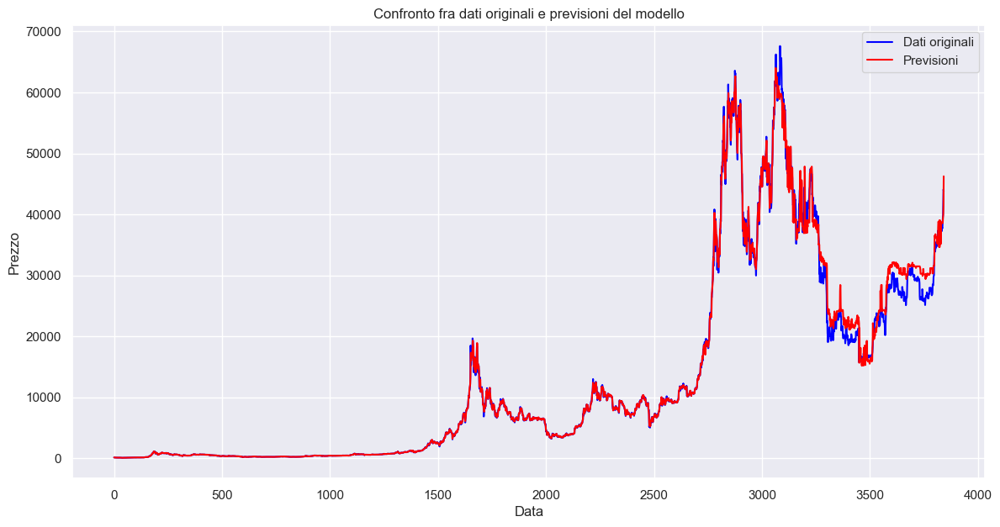

In [174]:
# Creo una colonna 'Previsioni' nel DataFrame originale
df['Previsioni'] = 0  # Inizializzo con valori dummy
df['Previsioni'] = previsioni_totali_modello_scelto

# Grafico dei dati originali e delle previsioni
plt.figure(figsize=(14, 7))
plt.plot(df.index, df[target_scelto], label='Dati originali', color='blue')
plt.plot(df.index, df['Previsioni'], label='Previsioni', color='red')
plt.title('Confronto fra dati originali e previsioni del modello')
plt.xlabel('Data')
plt.ylabel('Prezzo')
plt.legend()
plt.grid(True)
plt.show()

In [176]:
help(plot_tree)

Help on function plot_tree in module sklearn.tree._export:

plot_tree(decision_tree, *, max_depth=None, feature_names=None, class_names=None, label='all', filled=False, impurity=True, node_ids=False, proportion=False, rounded=False, precision=3, ax=None, fontsize=None)
    Plot a decision tree.
    
    The sample counts that are shown are weighted with any sample_weights that
    might be present.
    
    The visualization is fit automatically to the size of the axis.
    Use the ``figsize`` or ``dpi`` arguments of ``plt.figure``  to control
    the size of the rendering.
    
    Read more in the :ref:`User Guide <tree>`.
    
    .. versionadded:: 0.21
    
    Parameters
    ----------
    decision_tree : decision tree regressor or classifier
        The decision tree to be plotted.
    
    max_depth : int, default=None
        The maximum depth of the representation. If None, the tree is fully
        generated.
    
    feature_names : list of str, default=None
        Names of

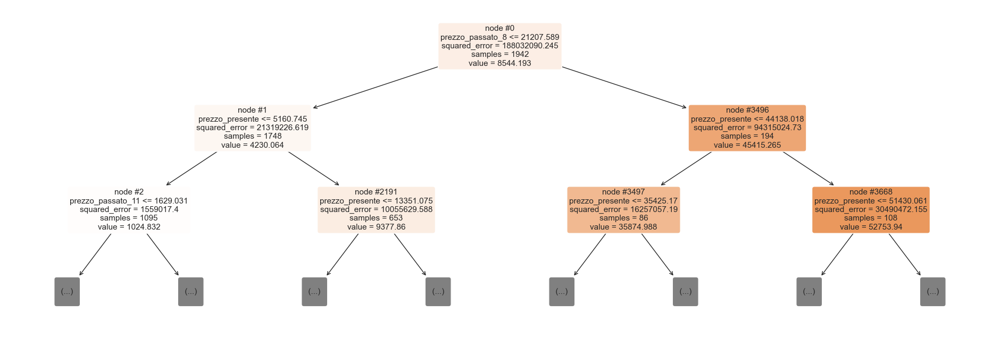

In [177]:
# Disegno l'albero con una profondità massima di 3 nodi
plt.figure(figsize=(24, 8))
plot_tree(modello_scelto.estimators_[0], filled=True, feature_names=X_train.columns, class_names=y_train.unique().astype(str), max_depth=2, node_ids = True, rounded = True)
plt.show()

In [132]:
quanti_alberi_vedere = 4
fn = X_train.columns
cn = y_train.unique().astype(str)
md = 2

fig, axes = plt.subplots(nrows = 2, ncols = 2, figsize = (10,10), dpi = 900)
for i in range(2):
    for j in range(2):
        index = i * 2 + j  # Calcolo l'indice dell'albero
        plt.sca(axes[i, j])  # Imposto l'asse corrente
        plot_tree(modello_scelto.estimators_[index], filled=True, feature_names=fn, class_names=cn, max_depth=md)

        axes[i, j].set_title('Albero ' + str(index+1), fontsize = 11)

# fig.savefig(f'Random forest custom + con {quanti_alberi_vedere} alberi.png')

<h6> Performance random forest </h6>

In [178]:
print('Performance sul training set:')
# Ottengo le probabilità previste
predizioni_train = modello_scelto.predict(X_train)


print('\nMSE:')
mse_train = mean_squared_error(y_train, predizioni_train)
print(mse_train)

print('\nMAPE:')
mape_train = mean_absolute_percentage_error(y_train, predizioni_train)
print(f'{round(mape_train*100, 2)}%')

print('\nMAE:')
mae_train = mean_absolute_error(y_train, predizioni_train)
print(mae_train)

print('\nR^2:')
r2_train = r2_score(y_train, predizioni_train)
print(f'{round(r2_train*100, 2)}%')

prime_3_metriche = [mse_train, mape_train, mae_train]

print('\nMedia aritmetica di MSE, MAPE e MAE:')
media_train = np.mean(prime_3_metriche)
print(media_train)

pesi_media_pesata = {
    'MSE': 1,
    'MAPE': 5,
    'MAE': 1
}

print('\nMedia pesata di MSE, MAPE e MAE:')
media_pesata_train = sum(x * w for x, w in zip(prime_3_metriche, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())
print(media_pesata_train)

Performance sul training set:

MSE:
102105.8889468857

MAPE:
1.22%

MAE:
112.64819882092257

R^2:
99.94%

Media aritmetica di MSE, MAPE e MAE:
34072.84979656383

Media pesata di MSE, MAPE e MAE:
14602.656909375846


In [179]:
print('Performance sul validation set:')
# Ottengo le probabilità previste
predizioni_val = modello_scelto.predict(X_val)


print('\nMSE:')
mse_val = mean_squared_error(y_val, predizioni_val)
print(mse_val)

print('\nMAPE:')
mape_val = mean_absolute_percentage_error(y_val, predizioni_val)
print(f'{round(mape_val*100, 2)}%')

print('\nMAE:')
mae_val = mean_absolute_error(y_val, predizioni_val)
print(mae_val)

print('\nR^2:')
r2_val = r2_score(y_val, predizioni_val)
print(f'{round(r2_val*100, 2)}%')

prime_3_metriche = [mse_val, mape_val, mae_val]

print('\nMedia aritmetica di MSE, MAPE e MAE:')
media_val = np.mean(prime_3_metriche)
print(media_val)

pesi_media_pesata = {
    'MSE': 1,
    'MAPE': 5,
    'MAE': 1
}

print('\nMedia pesata di MSE, MAPE e MAE:')
media_pesata_val = sum(x * w for x, w in zip(prime_3_metriche, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())
print(media_pesata_val)

Performance sul validation set:

MSE:
6998395.889395758

MAPE:
7.53%

MAE:
2200.5034986842625

R^2:
96.09%

Media aritmetica di MSE, MAPE e MAE:
2333532.1560768294

Media pesata di MSE, MAPE e MAE:
1000085.2527963817


In [180]:
print('Performance sul test set:')
# Ottengo le probabilità previste
predizioni_test = modello_scelto.predict(X_test)


print('\nMSE:')
mse_test = mean_squared_error(y_test, predizioni_test)
print(mse_test)

print('\nMAPE:')
mape_test = mean_absolute_percentage_error(y_test, predizioni_test)
print(f'{round(mape_test*100, 2)}%')

print('\nMAE:')
mae_test = mean_absolute_error(y_test, predizioni_test)
print(mae_test)

print('\nR^2:')
r2_test = r2_score(y_test, predizioni_test)
print(f'{round(r2_test*100, 2)}%')

prime_3_metriche = [mse_test, mape_test, mae_test]

print('\nMedia aritmetica di MSE, MAPE e MAE:')
media_test = np.mean(prime_3_metriche)
print(media_test)

pesi_media_pesata = {
    'MSE': 1,
    'MAPE': 5,
    'MAE': 1
}

print('\nMedia pesata di MSE, MAPE e MAE:')
media_pesata_test = sum(x * w for x, w in zip(prime_3_metriche, pesi_media_pesata.values())) / sum(pesi_media_pesata.values())
print(media_pesata_test)

Performance sul test set:

MSE:
6803618.0472757695

MAPE:
8.53%

MAE:
2242.7318686190797

R^2:
78.62%

Media aritmetica di MSE, MAPE e MAE:
2268620.2881386713

Media pesata di MSE, MAPE e MAE:
972265.8865003595


<h6> Feature importances </h6>

Importanza delle caratteristiche:
              Feature  Importance
0     prezzo_presente      0.4783
1    prezzo_passato_1      0.2634
8    prezzo_passato_8      0.1684
10  prezzo_passato_10      0.0848
11  prezzo_passato_11      0.0010
25  prezzo_passato_25      0.0006
2    prezzo_passato_2      0.0006
4    prezzo_passato_4      0.0005
17  prezzo_passato_17      0.0005
28  prezzo_passato_28      0.0003
32               Mese      0.0002
5    prezzo_passato_5      0.0001
3    prezzo_passato_3      0.0001
30  prezzo_passato_30      0.0001
6    prezzo_passato_6      0.0001
7    prezzo_passato_7      0.0001
29  prezzo_passato_29      0.0001
31             Giorno      0.0001
26  prezzo_passato_26      0.0001
27  prezzo_passato_27      0.0001
20  prezzo_passato_20      0.0001
19  prezzo_passato_19      0.0001
12  prezzo_passato_12      0.0001
9    prezzo_passato_9      0.0001
23  prezzo_passato_23      0.0001
18  prezzo_passato_18      0.0000
14  prezzo_passato_14      0.0000
16  prezzo_pas

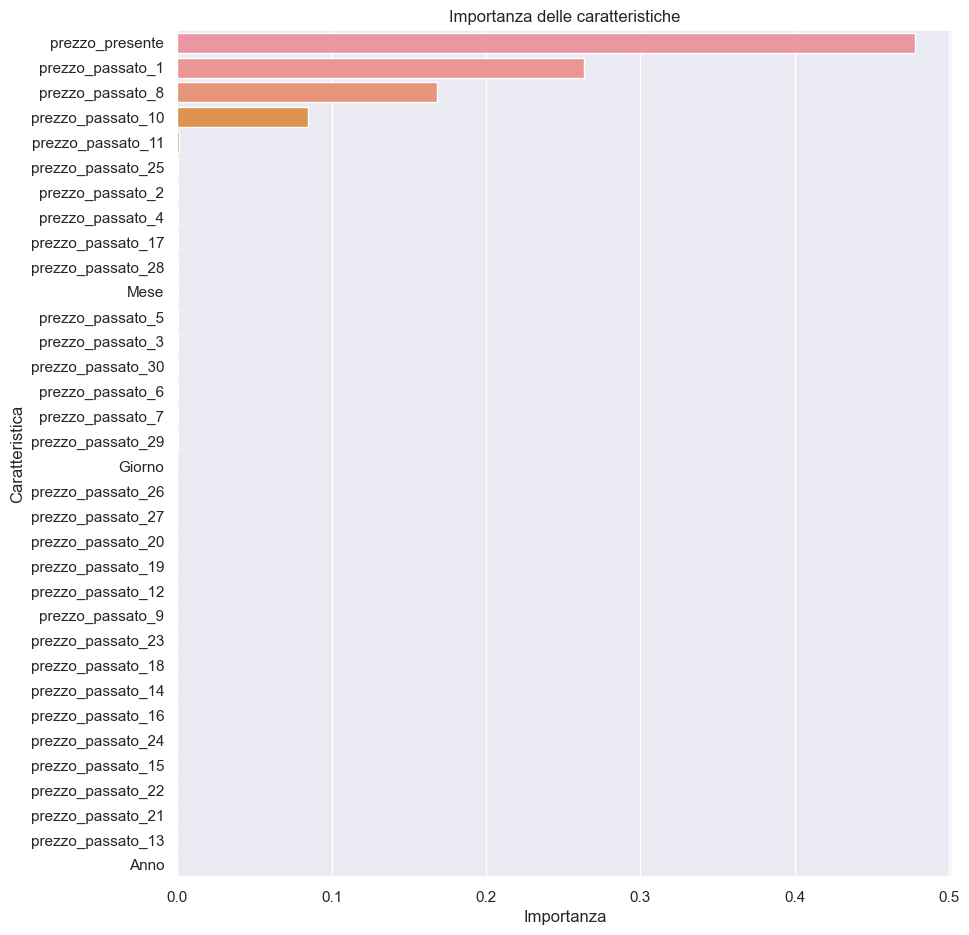

In [182]:
# Imposto il formato di stampa per le colonne decimali a 4 decimali
pd.set_option('display.float_format', '{:.4f}'.format)

# Estraggo l'importanza delle caratteristiche
feature_importance = modello_scelto.feature_importances_

# Prendo i nomi delle caratteristiche dal dataset
feature_names = X_train.columns

# Creo un DataFrame per la visualizzazione
feature_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importance})

# Ordino le caratteristiche per importanza
feature_df = feature_df.sort_values(by='Importance', ascending=False)
print('Importanza delle caratteristiche:')
print(feature_df)

# Visualizzo l'importanza delle caratteristiche
plt.figure(figsize=(10, round(len(feature_names)/3)))
sns.barplot(x='Importance', y='Feature', data=feature_df)
plt.title('Importanza delle caratteristiche')
plt.xlabel('Importanza')
plt.ylabel('Caratteristica')

percorso_immagine = r"C:\Users\Alessandro\Desktop\Cartelle\Mie\Programmi personali in Python\Kaggle\Bitcoin Historical Dataset\Feature importances (immagini)"
nome_immagine = f'Feature_importances_{numero_cartella}_{numero_modello}.png'
percorso_completo_immagine = percorso_immagine + "\\" + nome_immagine

# Salva l'immagine nel percorso specificato
plt.savefig(percorso_completo_immagine)

plt.show()

In [137]:
df_senza_valori_nan.columns

Index(['prezzo_futuro_1', 'prezzo_presente', 'prezzo_passato_29',
       'prezzo_passato_28', 'prezzo_passato_27', 'prezzo_passato_26',
       'prezzo_passato_25', 'prezzo_passato_24', 'prezzo_passato_23',
       'prezzo_passato_22', 'prezzo_passato_21', 'prezzo_passato_20',
       'prezzo_passato_19', 'prezzo_passato_18', 'prezzo_passato_17',
       'prezzo_passato_16', 'prezzo_passato_15', 'prezzo_passato_14',
       'prezzo_passato_13', 'prezzo_passato_12', 'prezzo_passato_11',
       'prezzo_passato_10', 'prezzo_passato_9', 'prezzo_passato_8',
       'prezzo_passato_7', 'prezzo_passato_6', 'prezzo_passato_5',
       'prezzo_passato_4', 'prezzo_passato_3', 'prezzo_passato_2',
       'prezzo_passato_1', 'prezzo_passato_30'],
      dtype='object')

### Creo un nuovo dataframe con nuove colonne

In [145]:
# Concateno i DataFrame X_train, X_val e X_test verticalmente
X_concatenato = pd.concat([X_train, X_val, X_test], axis=0)

# Concateno le etichette target y_train, y_val e y_test verticalmente
y_concatenato = pd.concat([y_train, y_val, y_test], axis=0)

# Creo una colonna 'Origine' con i flag che indicano l'origine dei dati
origine_train = ['Train'] * len(X_train)
origine_val = ['Test_1'] * len(X_val)
origine_test = ['Test out-of-sample'] * len(X_test)

origine = origine_train + origine_val + origine_test

# Creo un nuovo DataFrame con tutte le colonne desiderate
df_completo = pd.DataFrame(data=X_concatenato)
df_completo['Target_95'] = y_concatenato
df_completo['Origine'] = origine

df_completo

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84799,42.0000,0.4931,0.9167,0.0000,2528.7500,5.0000,49.2700,1.0000,3.0000,15.0000,668.0000,0.6111,1032.6700,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,1,0,1,Test out-of-sample
23810,57.0000,0.5667,0.8000,0.4366,2000.0000,8.0000,299.7500,2.0000,1.0000,29.0000,272.0000,0.7500,668.1400,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,Test out-of-sample
23132,30.0000,0.7083,1.2500,0.0493,2450.0000,12.0000,243.5100,2.0000,2.0000,31.0000,670.0000,0.9167,337.7800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,Test out-of-sample
83040,60.0000,0.5417,1.0000,0.0965,5577.0000,12.0000,124.3800,1.0000,6.0000,17.0000,1673.0000,0.7639,1732.0900,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,Test out-of-sample


In [146]:
ordine_colonne = dummies.columns
ordine_colonne

Index(['Target_95', 'Eta_Debitore', 'Severity_12M_pesata', 'Severity_12M',
       'RATIO_ONERI_AFF_TOT_AFF', 'IMP_FINANZIATO', 'Numero_mesi_rec',
       'TOT_AFF', 'DistanzaAffidoUltimoPagamento', 'DurataFinanziamentoAnni',
       'AgeingGestioneGg', 'AgeingErogazioneGg', 'Ratio_Rate_Imp1',
       'Cash Balance', 'Nazionalita_Italiano', 'Nazionalita_Non Valutabile',
       'Sesso_Non Valutabile', 'Sesso_Uomo',
       'Denominazione Regione_Basilicata', 'Denominazione Regione_Calabria',
       'Denominazione Regione_Campania',
       'Denominazione Regione_Emilia-Romagna',
       'Denominazione Regione_Friuli-Venezia Giulia',
       'Denominazione Regione_Lazio', 'Denominazione Regione_Liguria',
       'Denominazione Regione_Lombardia', 'Denominazione Regione_Marche',
       'Denominazione Regione_Molise', 'Denominazione Regione_Non Valutabile',
       'Denominazione Regione_Piemonte', 'Denominazione Regione_Puglia',
       'Denominazione Regione_Sardegna', 'Denominazione Regione_Sicili

In [147]:
# Calcolo le probabilità continue utilizzando il mio modello_scelto
features = ordine_colonne.drop('Target_95')

probabilità_continue = modello_scelto.predict_proba(df_completo[features])

# Estraggo le probabilità relative alla classe 1
probabilità_classe_1 = probabilità_continue[:, 1]

# Aggiungo una nuova colonna al DataFrame df_completo con le probabilità continue
df_completo['Probabilità_Target_95_predicted'] = probabilità_classe_1

df_completo

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84799,42.0000,0.4931,0.9167,0.0000,2528.7500,5.0000,49.2700,1.0000,3.0000,15.0000,668.0000,0.6111,1032.6700,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,1,0,1,Test out-of-sample,0.7327
23810,57.0000,0.5667,0.8000,0.4366,2000.0000,8.0000,299.7500,2.0000,1.0000,29.0000,272.0000,0.7500,668.1400,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,Test out-of-sample,0.0350
23132,30.0000,0.7083,1.2500,0.0493,2450.0000,12.0000,243.5100,2.0000,2.0000,31.0000,670.0000,0.9167,337.7800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,Test out-of-sample,0.3310
83040,60.0000,0.5417,1.0000,0.0965,5577.0000,12.0000,124.3800,1.0000,6.0000,17.0000,1673.0000,0.7639,1732.0900,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,Test out-of-sample,0.1593


In [148]:
df_completo.index

Int64Index([ 36698,  90092,    156,  37624,  69227, 102293,  63860,  72023,
             90078,  78772,
            ...
              4750,  73475,  66619,  74954,  66272,  84799,  23810,  23132,
             83040,  41883],
           dtype='int64', length=113621)

In [149]:
# Controllo se in df_clienti c'erano certe colonne
lista_check = ['CODICE_PHONIA', 'TOT REC', 'PRATICA', 'Chiave', 'TOT AFF']

sono_presenti_tutti = all(colonna in df_clienti.columns for colonna in lista_check)
sono_presenti_tutti

True

In [150]:
sorted(df_clienti.columns)

['AgeingErogazioneGg',
 'AgeingGestioneGg',
 'CODICE_PHONIA',
 'COD_FISC_INT',
 'CURRENT_BALANCE',
 'Cash Balance',
 'Chiave',
 'Codi_FISC_INT_2',
 'DATA AFFIDO',
 'DATA FINE LAV',
 'DATA_AFFIDO',
 'DATA_AGGIORNAMENTO',
 'DATA_ESTINZ',
 'DATA_FINANZIAM',
 'DATA_FINE_AFFIDO',
 'DELIN_HISTORY',
 'DES_BENE',
 'DES_PRODOTTO',
 'DT_VAL_RAT_IMP1',
 'DT_VAL_RAT_IMP2',
 'DT_VAL_ULT_PAGAM',
 'Denominazione Regione',
 'DistanzaAffidoUltimoPagamento',
 'DurataFinanziamentoAnni',
 'Eta_Debitore',
 'FlagRecOver100',
 'Flag_Cointestazione',
 'Flag_Galleggiamento_3M',
 'Flag_Galleggiamento_6M',
 'Flag_Garante',
 'Flag_Gestione_Prec',
 'Flag_InsolvenzaGrave_12M',
 'Flag_InsolvenzaGrave_3M',
 'Flag_InsolvenzaGrave_6M',
 'Flag_Miglioramento_3M',
 'Flag_Rate_piu_uno',
 'Flag_Riciclo_SDD',
 'Flag_Rifinanziamento',
 'Flag_Scivolamento_3M',
 'Flag_Scivolamento_6M',
 'Flag_rientrototale_6M',
 'IMP_FINANZIATO',
 'IMP_MAXIRATA',
 'IMP_PAG_RAT_IMP1',
 'IMP_PAG_RAT_IMP2',
 'IMP_RAT_IMP1',
 'IMP_RAT_IMP2',
 'MACR

In [151]:
df_completo

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84799,42.0000,0.4931,0.9167,0.0000,2528.7500,5.0000,49.2700,1.0000,3.0000,15.0000,668.0000,0.6111,1032.6700,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,1,0,1,Test out-of-sample,0.7327
23810,57.0000,0.5667,0.8000,0.4366,2000.0000,8.0000,299.7500,2.0000,1.0000,29.0000,272.0000,0.7500,668.1400,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,Test out-of-sample,0.0350
23132,30.0000,0.7083,1.2500,0.0493,2450.0000,12.0000,243.5100,2.0000,2.0000,31.0000,670.0000,0.9167,337.7800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,Test out-of-sample,0.3310
83040,60.0000,0.5417,1.0000,0.0965,5577.0000,12.0000,124.3800,1.0000,6.0000,17.0000,1673.0000,0.7639,1732.0900,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,Test out-of-sample,0.1593


In [152]:
# df_completo = df_completo.merge(df_clienti[lista_check], left_on=lista_colonne, right_on=lista_colonne, how='left')

In [153]:
# Faccio una left join per agganciarmi le colonne di lista_check
df_completo = df_completo.merge(df_clienti[lista_check], left_index=True, right_index=True, how='left')

In [154]:
df_completo

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted,CODICE_PHONIA,TOT REC,PRATICA,Chiave,TOT AFF
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101,ALPTEL,0.0000,00001529616301,00001529616301_10_2022,258.0000
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600,AQPTEL,293.8500,00002365625301,00002365625301_08_2022,293.8500
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000,AHPTEL,0.0000,00002273002301,00002273002301_09_2021,89.1500
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918,ALPTEL,259.1500,00005924519200,00005924519200_11_2022,530.3000
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969,ALPTEX,415.3000,00000863025301,00000863025301_04_2023,427.3000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84799,42.0000,0.4931,0.9167,0.0000,2528.7500,5.0000,49.2700,1.0000,3.0000,15.0000,668.0000,0.6111,1032.6700,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,1,0,1,Test out-of-sample,0.7327,AQPTEL,73.2400,00001990587301,00001990587301_05_2022,73.2400
23810,57.0000,0.5667,0.8000,0.4366,2000.0000,8.0000,299.7500,2.0000,1.0000,29.0000,272.0000,0.7500,668.1400,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,Test out-of-sample,0.0350,ALPTEL,336.3400,00002269045301,00002269045301_11_2021,467.2200
23132,30.0000,0.7083,1.2500,0.0493,2450.0000,12.0000,243.5100,2.0000,2.0000,31.0000,670.0000,0.9167,337.7800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,

In [155]:
df_completo['Target_95_predicted'] = round(df_completo['Probabilità_Target_95_predicted'])

In [156]:
# df_completo.rename(columns={'Target_95_continuo': 'Probabilità_Target_95_predicted'}, inplace=True)

In [157]:
df_completo

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted,CODICE_PHONIA,TOT REC,PRATICA,Chiave,TOT AFF,Target_95_predicted
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101,ALPTEL,0.0000,00001529616301,00001529616301_10_2022,258.0000,0.0000
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600,AQPTEL,293.8500,00002365625301,00002365625301_08_2022,293.8500,1.0000
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000,AHPTEL,0.0000,00002273002301,00002273002301_09_2021,89.1500,0.0000
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918,ALPTEL,259.1500,00005924519200,00005924519200_11_2022,530.3000,0.0000
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969,ALPTEX,415.3000,00000863025301,00000863025301_04_2023,427.3000,1.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84799,42.0000,0.4931,0.9167,0.0000,2528.7500,5.0000,49.2700,1.0000,3.0000,15.0000,668.0000,0.6111,1032.6700,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,1,0,1,Test out-of-sample,0.7327,AQPTEL,73.2400,00001990587301,00001990587301_05_2022,73.2400,1.0000
23810,57.0000,0.5667,0.8000,0.4366,2000.0000,8.0000,299.7500,2.0000,1.0000,29.0000,272.0000,0.7500,668.1400,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,Test out-of-sample,0.0350,ALPTEL,336.3400,00002269045301,00002269045301_11_2021,467.2200,0.0000
23132,30.0000,0.7083,1.2500,0.0493,2450.0000,12.0000,243.5100,2.0000,2.0000,31.0

<h6> Concateno i dati sintetici </h6>

In [158]:
X_sintetici = X_res[len(X_train):]

In [159]:
X_sintetici.shape

(20668, 55)

In [160]:
y_sintetici = y_res[len(y_train):]

In [161]:
y_sintetici.shape

(20668,)

In [162]:
set(df_completo.columns) - set(X_sintetici.columns)

{'CODICE_PHONIA',
 'Chiave',
 'Origine',
 'PRATICA',
 'Probabilità_Target_95_predicted',
 'TOT AFF',
 'TOT REC',
 'Target_95',
 'Target_95_predicted'}

In [163]:
set(X_sintetici.columns) - set(df_completo.columns)

set()

In [164]:
df_sintetici = pd.concat([X_sintetici, y_sintetici], axis=1)

In [165]:
df_sintetici

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95
92032,46.9806,0.1563,0.2885,0.5846,14326.3909,3.4618,66.1899,0.2885,10.0000,17.7115,1460.1593,0.3929,9939.4399,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1
92033,46.7984,0.4731,0.8061,0.0000,1329.0872,6.9278,49.7829,5.6540,2.5000,15.0000,364.4183,0.4000,866.9003,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1
92034,52.5375,0.4815,0.7873,0.0000,2663.6558,7.2903,106.0876,1.3011,2.3495,15.6021,367.6024,0.4283,1674.8231,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
92035,49.9968,0.1738,0.2504,0.0000,6060.9129,1.0022,147.0398,4.9978,4.0000,15.9995,1003.0000,0.6875,2203.7816,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1
92036,42.1884,0.1377,0.1377,0.0000,7285.5071,1.0000,131.7592,2.0000,5.8068,16.0000,191.9856,0.0909,6872.1661,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112695,50.0000,0.5375,0.9944,0.0481,15341.0034,11.3948,249.4304,1.0000,7.0000,15.0672,1525.1694,0.5968,7222.3175,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1
112696,50.6360,0.2412,0.2412,0.0000,7107.5050,1.0000,174.5472,2.0000,4.1060,16.0000,124.0741,0.0833,6772.3924,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1
112697,48.8778,0.6160,0.6852,0.2842,3021.7196,3.4344,214.9577,1.0000,1.7828,5.5656,198.8370,0.3098,2255.9582,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,1
112698,49.2543,0.5310,0.9197,0.0180,32397.7088,9.8179,679.5678,1.2182,9.3454,27.9450,1652.1845,0.4844,19489.1380,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [166]:
# Calcolo le probabilità continue utilizzando il mio modello_scelto
features = ordine_colonne.drop('Target_95')

probabilità_continue_sin = modello_scelto.predict_proba(df_sintetici[features])

# Estraggo le probabilità relative alla classe 1
probabilità_classe_1_sin = probabilità_continue_sin[:, 1]

# Aggiungo una nuova colonna al DataFrame df_completo con le probabilità continue
df_sintetici['Probabilità_Target_95_predicted'] = probabilità_classe_1_sin

df_sintetici

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Probabilità_Target_95_predicted
92032,46.9806,0.1563,0.2885,0.5846,14326.3909,3.4618,66.1899,0.2885,10.0000,17.7115,1460.1593,0.3929,9939.4399,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0.9500
92033,46.7984,0.4731,0.8061,0.0000,1329.0872,6.9278,49.7829,5.6540,2.5000,15.0000,364.4183,0.4000,866.9003,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1,0.9550
92034,52.5375,0.4815,0.7873,0.0000,2663.6558,7.2903,106.0876,1.3011,2.3495,15.6021,367.6024,0.4283,1674.8231,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1.0000
92035,49.9968,0.1738,0.2504,0.0000,6060.9129,1.0022,147.0398,4.9978,4.0000,15.9995,1003.0000,0.6875,2203.7816,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0.9935
92036,42.1884,0.1377,0.1377,0.0000,7285.5071,1.0000,131.7592,2.0000,5.8068,16.0000,191.9856,0.0909,6872.1661,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0.9567
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112695,50.0000,0.5375,0.9944,0.0481,15341.0034,11.3948,249.4304,1.0000,7.0000,15.0672,1525.1694,0.5968,7222.3175,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0.9267
112696,50.6360,0.2412,0.2412,0.0000,7107.5050,1.0000,174.5472,2.0000,4.1060,16.0000,124.0741,0.0833,6772.3924,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,0.9620
112697,48.8778,0.6160,0.6852,0.2842,3021.7196,3.4344,214.9577,1.0000,1.7828,5.5656,198.8370,0.3098,2255.9582,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,1,0.8545
112698,49.2543,0.5310,0.9197,0.0180,32397.7088,9.8179,679.5678,1.2182,9.3454,27.9450,1652.1845,0.4844,19489.1380,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0.9442


In [167]:
df_sintetici['Target_95_predicted'] = round(df_sintetici['Probabilità_Target_95_predicted'])

In [168]:
df_sintetici['Origine'] = 'Train'

In [169]:
df_sintetici['CODICE_PHONIA'] = 'Non presente'

In [170]:
df_sintetici['Chiave'] = 'Non presente'

In [171]:
df_sintetici['PRATICA'] = 'Non presente'

In [172]:
df_sintetici['TOT AFF'] = np.nan

In [173]:
df_sintetici['TOT REC'] = np.nan

In [174]:
# Riordino le colonne di df_sintetici
df_sintetici = df_sintetici[df_completo.columns]

In [175]:
df_sintetici

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted,CODICE_PHONIA,TOT REC,PRATICA,Chiave,TOT AFF,Target_95_predicted
92032,46.9806,0.1563,0.2885,0.5846,14326.3909,3.4618,66.1899,0.2885,10.0000,17.7115,1460.1593,0.3929,9939.4399,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.9500,Non presente,NaN,Non presente,Non presente,NaN,1.0000
92033,46.7984,0.4731,0.8061,0.0000,1329.0872,6.9278,49.7829,5.6540,2.5000,15.0000,364.4183,0.4000,866.9003,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1,Train,0.9550,Non presente,NaN,Non presente,Non presente,NaN,1.0000
92034,52.5375,0.4815,0.7873,0.0000,2663.6558,7.2903,106.0876,1.3011,2.3495,15.6021,367.6024,0.4283,1674.8231,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,Train,1.0000,Non presente,NaN,Non presente,Non presente,NaN,1.0000
92035,49.9968,0.1738,0.2504,0.0000,6060.9129,1.0022,147.0398,4.9978,4.0000,15.9995,1003.0000,0.6875,2203.7816,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,Train,0.9935,Non presente,NaN,Non presente,Non presente,NaN,1.0000
92036,42.1884,0.1377,0.1377,0.0000,7285.5071,1.0000,131.7592,2.0000,5.8068,16.0000,191.9856,0.0909,6872.1661,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,Train,0.9567,Non presente,NaN,Non presente,Non presente,NaN,1.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112695,50.0000,0.5375,0.9944,0.0481,15341.0034,11.3948,249.4304,1.0000,7.0000,15.0672,1525.1694,0.5968,7222.3175,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.9267,Non presente,NaN,Non presente,Non presente,NaN,1.0000
112696,50.6360,0.2412,0.2412,0.0000,7107.5050,1.0000,174.5472,2.0000,4.1060,16.0000,124.0741,0.0833,6772.3924,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,Train,0.9620,Non presente,NaN,Non presente,Non presente,NaN,1.0000
112697,48.8778,0.6160,0.6852,0.2842,3021.7196,3.4344,214.9577,1.0000,1.7828,5.5656,198.8370,0.3098,2255.9582,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,1,Train,0.8545,Non 

In [176]:
df_sintetici.isna().sum()

Eta_Debitore                   0
Severity_12M_pesata            0
Severity_12M                   0
RATIO_ONERI_AFF_TOT_AFF        0
IMP_FINANZIATO                 0
                           ...  
TOT REC                    20668
PRATICA                        0
Chiave                         0
TOT AFF                    20668
Target_95_predicted            0
Length: 64, dtype: int64

<h6> Aggiungo una colonna 'Sintetico' per dire se quella riga è sintetica o no </h6>

In [177]:
df_completo['Sintetico'] = False

In [178]:
df_sintetici['Sintetico'] = True

C:\Users\qj1aleimbria\AppData\Local\Temp\ipykernel_16512\195944584.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sintetici['Sintetico'] = True


<h6> Aggancio di df_completo con df_sintetici </h6>

In [179]:
df_completo_con_sintetici = pd.concat([df_completo, df_sintetici], axis = 0)

In [180]:
df_completo_con_sintetici

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted,CODICE_PHONIA,TOT REC,PRATICA,Chiave,TOT AFF,Target_95_predicted,Sintetico
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101,ALPTEL,0.0000,00001529616301,00001529616301_10_2022,258.0000,0.0000,False
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600,AQPTEL,293.8500,00002365625301,00002365625301_08_2022,293.8500,1.0000,False
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000,AHPTEL,0.0000,00002273002301,00002273002301_09_2021,89.1500,0.0000,False
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918,ALPTEL,259.1500,00005924519200,00005924519200_11_2022,530.3000,0.0000,False
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969,ALPTEX,415.3000,00000863025301,00000863025301_04_2023,427.3000,1.0000,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112695,50.0000,0.5375,0.9944,0.0481,15341.0034,11.3948,249.4304,1.0000,7.0000,15.0672,1525.1694,0.5968,7222.3175,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.9267,Non presente,NaN,Non presente,Non presente,NaN,1.0000,True
112696,50.6360,0.2412,0.2412,0.0000,7107.5050,1.0000,174.5472,2.0000,4.1060,16.0000,124.0741,0.0833,6772.3924,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,Train,0.9620,Non presente,NaN,Non presente,Non presente,NaN,1.0000,True
112697,48.8778,0.6160,0.6852,0.2842,3021.7196,3.4344,214.9577,1.0000,1.7828

### Suddivisione in classi usando Jenkspy

In [181]:
breaks_10 = jenkspy.jenks_breaks(df_completo_con_sintetici['Probabilità_Target_95_predicted'], n_classes=10)
breaks_10

[0.0,
 0.07298720259350883,
 0.14789473684210525,
 0.23745112781954889,
 0.357182235456943,
 0.5066880101875517,
 0.6527403846153845,
 0.7671773413511418,
 0.8571555255216436,
 0.9383447488584475,
 1.0]

In [182]:
# Estendo l'intervallo dei breaks_10 mettendo un numero negativo piccolo al posto di 0.0, altrimenti se la probabilità è esattamente 0.0 mi viene fuori NaN come classe
breaks_10_estesa = breaks_10
breaks_10_estesa[0] = -0.0001

In [183]:
breaks_10_estesa

[-0.0001,
 0.07298720259350883,
 0.14789473684210525,
 0.23745112781954889,
 0.357182235456943,
 0.5066880101875517,
 0.6527403846153845,
 0.7671773413511418,
 0.8571555255216436,
 0.9383447488584475,
 1.0]

In [ ]:
percorso_desiderato = r"C:\Users\qj1aleimbria\Desktop\File VS Code\11 - 16 10 23 (ML su Prestitempo)\Intervalli scelti da Jenkspy"
nome_file = f"Intervalli scelti da Jenkspy per modello {numero_cartella}_{numero_modello} con {numero_sintetici} dati sintetici.txt"

percorso_completo = percorso_desiderato + '\\' + nome_file

contenuto_da_salvare = str(breaks_10_estesa)

with open(percorso_completo, 'w') as file:
    file.write(contenuto_da_salvare)

print(f"Il contenuto della variabile è stato salvato con successo in {percorso_completo}.")

In [184]:
n = 10
bin_labels = [f"{i}" for i in range(1, n+1)]

df_completo_con_sintetici['Classe_Score_Target_95'] = pd.cut(df_completo_con_sintetici['Probabilità_Target_95_predicted'],
                       bins=breaks_10_estesa,
                       labels= bin_labels)

In [185]:
df_completo_con_sintetici

,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI,Target_95,Origine,Probabilità_Target_95_predicted,CODICE_PHONIA,TOT REC,PRATICA,Chiave,TOT AFF,Target_95_predicted,Sintetico,Classe_Score_Target_95
36698,52.0000,1.5208,2.2500,0.0434,5000.0000,12.0000,276.2500,0.0000,4.0000,999.0000,1126.0000,0.7708,1407.7700,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,Train,0.0101,ALPTEL,0.0000,00001529616301,00001529616301_10_2022,258.0000,0.0000,False,1
90092,50.0000,0.6181,1.1667,0.0000,19586.0000,12.0000,263.2400,1.0000,3.0833,14.0000,456.0000,0.4054,17528.0300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,Train,0.8600,AQPTEL,293.8500,00002365625301,00002365625301_08_2022,293.8500,1.0000,False,9
156,24.0000,1.3452,1.5714,0.2015,1500.0000,6.0000,90.0600,1.0000,2.0000,16.0000,183.0000,0.2500,1218.7400,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,Train,0.1000,AHPTEL,0.0000,00002273002301,00002273002301_09_2021,89.1500,0.0000,False,2
37624,52.0000,0.7014,1.1667,0.0387,16439.9000,12.0000,310.2200,0.0000,7.0000,28.0000,2434.0000,0.9524,1266.7900,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,Train,0.0918,ALPTEL,259.1500,00005924519200,00005924519200_11_2022,530.3000,0.0000,False,2
69227,41.0000,0.5417,1.0000,0.0000,14224.0000,12.0000,252.0700,1.0000,8.0000,15.0000,1743.0000,0.5938,7217.5800,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.7969,ALPTEX,415.3000,00000863025301,00000863025301_04_2023,427.3000,1.0000,False,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112695,50.0000,0.5375,0.9944,0.0481,15341.0034,11.3948,249.4304,1.0000,7.0000,15.0672,1525.1694,0.5968,7222.3175,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,Train,0.9267,Non presente,NaN,Non presente,Non presente,NaN,1.0000,True,9
112696,50.6360,0.2412,0.2412,0.0000,7107.5050,1.0000,174.5472,2.0000,4.1060,16.0000,124.0741,0.0833,6772.3924,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,1,Train,0.9620,Non presente,NaN,Non presente,Non presente,NaN,1.0000,True,10
112697,48.8778,0.6160,0.6852,0.28

In [186]:
df_completo_con_sintetici.isna().sum().sum()

41336

In [187]:
colonne_finali = ['PRATICA', 'Chiave', 'CODICE_PHONIA', 'Origine', 'Classe_Score_Target_95', 'Probabilità_Target_95_predicted', 'TOT REC', 'TOT AFF', 'Target_95', 'Target_95_predicted', 'Sintetico']
colonne_finali.extend(X_train.columns)
colonne_finali

['PRATICA',
 'Chiave',
 'CODICE_PHONIA',
 'Origine',
 'Classe_Score_Target_95',
 'Probabilità_Target_95_predicted',
 'TOT REC',
 'TOT AFF',
 'Target_95',
 'Target_95_predicted',
 'Sintetico',
 'Eta_Debitore',
 'Severity_12M_pesata',
 'Severity_12M',
 'RATIO_ONERI_AFF_TOT_AFF',
 'IMP_FINANZIATO',
 'Numero_mesi_rec',
 'TOT_AFF',
 'DistanzaAffidoUltimoPagamento',
 'DurataFinanziamentoAnni',
 'AgeingGestioneGg',
 'AgeingErogazioneGg',
 'Ratio_Rate_Imp1',
 'Cash Balance',
 'Nazionalita_Italiano',
 'Nazionalita_Non Valutabile',
 'Sesso_Non Valutabile',
 'Sesso_Uomo',
 'Denominazione Regione_Basilicata',
 'Denominazione Regione_Calabria',
 'Denominazione Regione_Campania',
 'Denominazione Regione_Emilia-Romagna',
 'Denominazione Regione_Friuli-Venezia Giulia',
 'Denominazione Regione_Lazio',
 'Denominazione Regione_Liguria',
 'Denominazione Regione_Lombardia',
 'Denominazione Regione_Marche',
 'Denominazione Regione_Molise',
 'Denominazione Regione_Non Valutabile',
 'Denominazione Regione_Pie

In [188]:
df_completo_con_sintetici = df_completo_con_sintetici[colonne_finali]

In [189]:
df_completo_con_sintetici.shape

(134289, 66)

### Riordino il df_completo e lo esporto

In [190]:
df_completo_riordinato = df_completo_con_sintetici.copy()

In [191]:
df_completo_riordinato = df_completo_riordinato.sort_index()

In [192]:
df_completo_riordinato

,PRATICA,Chiave,CODICE_PHONIA,Origine,Classe_Score_Target_95,Probabilità_Target_95_predicted,TOT REC,TOT AFF,Target_95,Target_95_predicted,Sintetico,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI
0,00000192490301,00000192490301_08_2021,AHPTEL,Train,1,0.0161,0.0000,210.0000,0,0.0000,False,50.0000,1.1944,2.2500,0.0412,8750.7000,12.0000,291.4200,0.0000,5.0000,17.0000,1582.0000,0.8667,1689.6300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0
1,00000475601301,00000475601301_08_2021,AHPTEL,Test_1,6,0.5675,0.0000,522.8800,0,1.0000,False,50.0000,0.0833,0.0833,0.0229,23615.0000,1.0000,524.9800,17.0000,6.1667,-999.0000,2282.0000,0.4054,13422.3300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2,00005101916200,00005101916200_08_2021,AHPTEL,Test_1,2,0.1121,0.0000,151.0000,0,0.0000,False,56.0000,0.9722,1.6667,0.0785,12680.8200,12.0000,152.8700,0.0000,12.0000,17.0000,3133.0000,0.6806,5600.1400,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0
3,00001553388301,00001553388301_08_2021,AHPTEL,Train,2,0.0850,0.0000,88.0000,0,0.0000,False,57.0000,1.0347,1.5000,0.1265,4200.0000,11.0000,94.8500,0.0000,6.0000,17.0000,669.0000,0.3056,3190.7100,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0
4,00001780466301,00001780466301_08_2021,AHPTEL,Train,2,0.0810,0.0000,212.8200,0,0.0000,False,50.0000,1.1181,1.6667,0.0550,12900.0000,10.0000,218.3600,1.0000,7.3333,-999.0000,2707.0000,0.0341,11686.7800,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122123,00002287283301,00002287283301_10_2023,AQPTEL,Train,8,0.7744,68.5000,68.5000,1,1.0000,False,65.0000,0.3681,0.8333,0.0000,2050.0000,2.0000,69.4000,2.0000,3.0000,17.0000,974.0000,0.8333,458.2900,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0
122125,00000315666301,00000315666301_10_2023,AQPTEL,Train,2,0.0800,32.0000,54.5000,0,0.0000,False,69.0000,0.4375,0.6667,0.0000,3150.0000,1.0000,23.6600,4.0000,7.0000,17.0000,2313.0000,0.8929,468.6300,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,1,0,0
122126,00003304946301,000

In [193]:
# sposto le nuove colonne all'inizio
# ultime_11_colonne = df_completo_riordinato.iloc[:, -14:]
# resto_del_dataframe = df_completo_riordinato.iloc[:, :-14]
# df_completo_riordinato = pd.concat([ultime_11_colonne, resto_del_dataframe], axis=1)

In [194]:
df_completo_riordinato

,PRATICA,Chiave,CODICE_PHONIA,Origine,Classe_Score_Target_95,Probabilità_Target_95_predicted,TOT REC,TOT AFF,Target_95,Target_95_predicted,Sintetico,Eta_Debitore,Severity_12M_pesata,Severity_12M,RATIO_ONERI_AFF_TOT_AFF,IMP_FINANZIATO,Numero_mesi_rec,TOT_AFF,DistanzaAffidoUltimoPagamento,DurataFinanziamentoAnni,AgeingGestioneGg,AgeingErogazioneGg,Ratio_Rate_Imp1,Cash Balance,Nazionalita_Italiano,Nazionalita_Non Valutabile,Sesso_Non Valutabile,Sesso_Uomo,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Flag_Galleggiamento_6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,Flag_InsolvenzaGrave_12M_SI,Flag_rientrototale_6M_SI,Flag_Rate_piu_uno_SI,Flag_Gestione_Prec_SI,Flag_Galleggiamento_3M_SI,NOSTART12M_SI
0,00000192490301,00000192490301_08_2021,AHPTEL,Train,1,0.0161,0.0000,210.0000,0,0.0000,False,50.0000,1.1944,2.2500,0.0412,8750.7000,12.0000,291.4200,0.0000,5.0000,17.0000,1582.0000,0.8667,1689.6300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0
1,00000475601301,00000475601301_08_2021,AHPTEL,Test_1,6,0.5675,0.0000,522.8800,0,1.0000,False,50.0000,0.0833,0.0833,0.0229,23615.0000,1.0000,524.9800,17.0000,6.1667,-999.0000,2282.0000,0.4054,13422.3300,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2,00005101916200,00005101916200_08_2021,AHPTEL,Test_1,2,0.1121,0.0000,151.0000,0,0.0000,False,56.0000,0.9722,1.6667,0.0785,12680.8200,12.0000,152.8700,0.0000,12.0000,17.0000,3133.0000,0.6806,5600.1400,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0
3,00001553388301,00001553388301_08_2021,AHPTEL,Train,2,0.0850,0.0000,88.0000,0,0.0000,False,57.0000,1.0347,1.5000,0.1265,4200.0000,11.0000,94.8500,0.0000,6.0000,17.0000,669.0000,0.3056,3190.7100,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0
4,00001780466301,00001780466301_08_2021,AHPTEL,Train,2,0.0810,0.0000,212.8200,0,0.0000,False,50.0000,1.1181,1.6667,0.0550,12900.0000,10.0000,218.3600,1.0000,7.3333,-999.0000,2707.0000,0.0341,11686.7800,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122123,00002287283301,00002287283301_10_2023,AQPTEL,Train,8,0.7744,68.5000,68.5000,1,1.0000,False,65.0000,0.3681,0.8333,0.0000,2050.0000,2.0000,69.4000,2.0000,3.0000,17.0000,974.0000,0.8333,458.2900,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0
122125,00000315666301,00000315666301_10_2023,AQPTEL,Train,2,0.0800,32.0000,54.5000,0,0.0000,False,69.0000,0.4375,0.6667,0.0000,3150.0000,1.0000,23.6600,4.0000,7.0000,17.0000,2313.0000,0.8929,468.6300,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,1,1,0,0
122126,00003304946301,000

In [195]:
df_completo_riordinato.to_excel(f'df_completo_riordinato_standard_52_85_SMOTE_Target_95.xlsx', sheet_name='DF completo')

In [350]:
# Aggiungo una seconda scheda con le feature importances con one-hot
nome_file = f'df_completo_riordinato_standard_{numero_cartella}_{numero_modello}_SMOTE_Target_95.xlsx'
with pd.ExcelWriter(nome_file, engine='openpyxl', mode='a') as writer:
    feature_df.to_excel(writer, sheet_name='F.I. con one-hot', index=False)

In [351]:
# Aggiungo una terza scheda con le feature importances con one-hot
nome_file = f'df_completo_riordinato_standard_{numero_cartella}_{numero_modello}_SMOTE_Target_95.xlsx'
with pd.ExcelWriter(nome_file, engine='openpyxl', mode='a') as writer:
    aggregated_feature_df.to_excel(writer, sheet_name='F.I. senza one-hot', index=False)

In [ ]:
# Aggiungo una quarta scheda con le performance sul train
# Creo un DataFrame per i risultati
results_train = {
    'Metrica': ['Accuracy', 'Balanced Accuracy', 'Precision', 'Recall', 'F1-score', 'AUC', 'Media', 'Media pesata'],
    'Valore': [accuracy_train, balanced_accuracy_train, precision_train, recall_train, f1_train, roc_auc_train, media_train, media_pesata_train]
}
results_df_train = pd.DataFrame(results_train)

# Creo un writer Excel con openpyxl
with pd.ExcelWriter(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx', engine='openpyxl', mode='a') as writer:
    # Scrivo il DataFrame dei risultati nella nuova scheda
    results_df_train.to_excel(writer, sheet_name='Train performances', index=False)

    # Ottengo l'oggetto scheda
    sheet_train = writer.sheets['Train performances']

    # Aggiungo la matrice di confusione
    sheet_train['A9'] = 'Matrice di confusione:'
    sheet_train['B10'] = 'Predicted 0'
    sheet_train['C10'] = 'Predicted 1'
    for idx, row in enumerate(confusion_df_train.iterrows(), start=11):
        sheet_train[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_train.cell(row=idx, column=i).value = value

    # Aggiungo il classification report
    sheet_train['A15'] = 'Classification report:'
    sheet_train['B16'] = 'precision'
    sheet_train['C16'] = 'recall'
    sheet_train['D16'] = 'f1-score'
    sheet_train['E16'] = 'support'

    for idx, row in enumerate(df_train.iterrows(), start=17):
        sheet_train[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_train.cell(row=idx, column=i).value = value

In [ ]:
# Inserisco l'immagine nel file Excel
wb = load_workbook(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')
ws = wb['Train performances']
img = Image(f'ROC_curve_custom_train_{numero_cartella}_{numero_modello}.png')
ws.add_image(img, 'G1')
wb.save(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')

In [ ]:
# Aggiungo una quinta scheda con le performance sul resampled
# Creo un DataFrame per i risultati
results_res = {
    'Metrica': ['Accuracy', 'Balanced Accuracy', 'Precision', 'Recall', 'F1-score', 'AUC', 'Media', 'Media pesata'],
    'Valore': [accuracy_res, balanced_accuracy_res, precision_res, recall_res, f1_res, roc_auc_res, media_res, media_pesata_res]
}
results_df_res = pd.DataFrame(results_res)

# Creo un writer Excel con openpyxl
with pd.ExcelWriter(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx', engine='openpyxl', mode='a') as writer:
    # Scrivo il DataFrame dei risultati nella nuova scheda
    results_df_res.to_excel(writer, sheet_name='Resampled performances', index=False)

    # Ottengo l'oggetto scheda
    sheet_res = writer.sheets['Resampled performances']

    # Aggiungo la matrice di confusione
    sheet_res['A9'] = 'Matrice di confusione:'
    sheet_res['B10'] = 'Predicted 0'
    sheet_res['C10'] = 'Predicted 1'
    for idx, row in enumerate(confusion_df_res.iterrows(), start=11):
        sheet_res[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_res.cell(row=idx, column=i).value = value

    # Aggiungo il classification report
    sheet_res['A15'] = 'Classification report:'
    sheet_res['B16'] = 'precision'
    sheet_res['C16'] = 'recall'
    sheet_res['D16'] = 'f1-score'
    sheet_res['E16'] = 'support'

    for idx, row in enumerate(df_res.iterrows(), start=17):
        sheet_res[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_res.cell(row=idx, column=i).value = value

In [ ]:
# Inserisco l'immagine nel file Excel
wb = load_workbook(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')
ws = wb['Resampled performances']
img = Image(f'ROC_curve_custom_resampled_{numero_cartella}_{numero_modello}.png')
ws.add_image(img, 'G1')
wb.save(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')

In [ ]:
# Aggiungo una sesta scheda con le performance sul test_1/validation
# Creo un DataFrame per i risultati
results_val = {
    'Metrica': ['Accuracy', 'Balanced Accuracy', 'Precision', 'Recall', 'F1-score', 'AUC', 'Media', 'Media pesata'],
    'Valore': [accuracy_val, balanced_accuracy_val, precision_val, recall_val, f1_val, roc_auc_val, media_val, media_pesata_val]
}
results_df_val = pd.DataFrame(results_val)

# Creo un writer Excel con openpyxl
with pd.ExcelWriter(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx', engine='openpyxl', mode='a') as writer:
    # Scrivo il DataFrame dei risultati nella nuova scheda
    results_df_val.to_excel(writer, sheet_name='Test_1 performances', index=False)

    # Ottengo l'oggetto scheda
    sheet_val = writer.sheets['Test_1 performances']

    # Aggiungo la matrice di confusione
    sheet_val['A9'] = 'Matrice di confusione:'
    sheet_val['B10'] = 'Predicted 0'
    sheet_val['C10'] = 'Predicted 1'
    for idx, row in enumerate(confusion_df_val.iterrows(), start=11):
        sheet_val[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_val.cell(row=idx, column=i).value = value

    # Aggiungo il classification report
    sheet_val['A15'] = 'Classification report:'
    sheet_val['B16'] = 'precision'
    sheet_val['C16'] = 'recall'
    sheet_val['D16'] = 'f1-score'
    sheet_val['E16'] = 'support'

    for idx, row in enumerate(df_val.iterrows(), start=17):
        sheet_val[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_val.cell(row=idx, column=i).value = value

In [ ]:
# Inserisco l'immagine nel file Excel
wb = load_workbook(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')
ws = wb['Test_1 performances']
img = Image(f'ROC_curve_custom_test_1_{numero_cartella}_{numero_modello}.png')
ws.add_image(img, 'G1')
wb.save(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')

In [ ]:
# Aggiungo una settima scheda con le performance sul test_2/test/test out-of-sample
# Creo un DataFrame per i risultati
results_test = {
    'Metrica': ['Accuracy', 'Balanced Accuracy', 'Precision', 'Recall', 'F1-score', 'AUC', 'Media', 'Media pesata'],
    'Valore': [accuracy_test, balanced_accuracy_test, precision_test, recall_test, f1_test, roc_auc_test, media_test, media_pesata_test]
}
results_df_test = pd.DataFrame(results_test)

# Creo un writer Excel con openpyxl
with pd.ExcelWriter(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx', engine='openpyxl', mode='a') as writer:
    # Scrivo il DataFrame dei risultati nella nuova scheda
    results_df_test.to_excel(writer, sheet_name='Test out-of-sample performances', index=False)

    # Ottengo l'oggetto scheda
    sheet_test = writer.sheets['Test out-of-sample performances']

    # Aggiungo la matrice di confusione
    sheet_test['A9'] = 'Matrice di confusione:'
    sheet_test['B10'] = 'Predicted 0'
    sheet_test['C10'] = 'Predicted 1'
    for idx, row in enumerate(confusion_df_test.iterrows(), start=11):
        sheet_test[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_test.cell(row=idx, column=i).value = value

    # Aggiungo il classification report
    sheet_test['A15'] = 'Classification report:'
    sheet_test['B16'] = 'precision'
    sheet_test['C16'] = 'recall'
    sheet_test['D16'] = 'f1-score'
    sheet_test['E16'] = 'support'

    for idx, row in enumerate(df_test.iterrows(), start=17):
        sheet_test[f'A{idx}'] = row[0]
        for i, value in enumerate(row[1], start=2):
            sheet_test.cell(row=idx, column=i).value = value

In [ ]:
# Inserisco l'immagine nel file Excel
wb = load_workbook(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')
ws = wb['Test out-of-sample performances']
img = Image(f'ROC_curve_custom_test_out_of_sample_{numero_cartella}_{numero_modello}.png')
ws.add_image(img, 'G1')
wb.save(f'df_completo_riordinato_custom_{numero_cartella}_{numero_modello}.xlsx')

### Distribuzione del target continuo

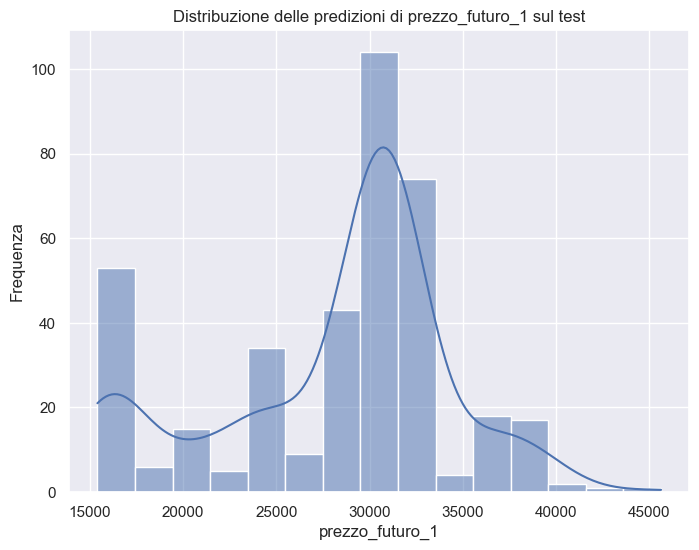

In [90]:
colonna_da_plottare = 'prezzo_futuro_1'

# Crea un istogramma utilizzando seaborn
plt.figure(figsize=(8, 6))
sns.histplot(predizioni_test, kde=True)  # kde=True aggiunge la stima della densità kernel
plt.title(f'Distribuzione delle predizioni di {colonna_da_plottare} sul test')
plt.xlabel(colonna_da_plottare)
plt.ylabel('Frequenza')
plt.show()

### Previsione dati inventati

In [437]:
X_res.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113728 entries, 0 to 113727
Data columns (total 52 columns):
 #   Column                                              Non-Null Count   Dtype  
---  ------                                              --------------   -----  
 0   Eta_Debitore                                        113728 non-null  float64
 1   RATIO_ONERI_AFF_TOT_AFF                             113728 non-null  float64
 2   Cash Balance                                        113728 non-null  float64
 3   DurataFinanziamentoAnni                             113728 non-null  float64
 4   IMP_FINANZIATO                                      113728 non-null  float64
 5   AgeingErogazioneGg                                  113728 non-null  float64
 6   TOT_AFF                                             113728 non-null  float64
 7   Ratio_Rate_Imp1                                     113728 non-null  float64
 8   DistanzaAffidoUltimoPagamento                       113728 non-n

In [438]:
X_res.iloc[0:1]

,Eta_Debitore,RATIO_ONERI_AFF_TOT_AFF,Cash Balance,DurataFinanziamentoAnni,IMP_FINANZIATO,AgeingErogazioneGg,TOT_AFF,Ratio_Rate_Imp1,DistanzaAffidoUltimoPagamento,AgeingGestioneGg,Sesso_Non Valutabile,Sesso_Uomo,Nazionalita_Italiano,Nazionalita_Non Valutabile,Denominazione Regione_Basilicata,Denominazione Regione_Calabria,Denominazione Regione_Campania,Denominazione Regione_Emilia-Romagna,Denominazione Regione_Friuli-Venezia Giulia,Denominazione Regione_Lazio,Denominazione Regione_Liguria,Denominazione Regione_Lombardia,Denominazione Regione_Marche,Denominazione Regione_Molise,Denominazione Regione_Non Valutabile,Denominazione Regione_Piemonte,Denominazione Regione_Puglia,Denominazione Regione_Sardegna,Denominazione Regione_Sicilia,Denominazione Regione_Toscana,Denominazione Regione_Trentino-Alto Adige/Südtirol,Denominazione Regione_Umbria,Denominazione Regione_Valle d'Aosta/Vallée d'Aoste,Denominazione Regione_Veneto,Metodo_pagamento_RI,NOSTART12M_SI,NOSTART6M_SI,DESCRIZIONE PRODOTTO_ARREDAMENTO,DESCRIZIONE PRODOTTO_AUTOMOTIVE NUOVO,DESCRIZIONE PRODOTTO_AUTOMOTIVE USATO,DESCRIZIONE PRODOTTO_ELETTRONICA & ELETTRODOME,DESCRIZIONE PRODOTTO_FINANZIAMENTI AZIENDE,DESCRIZIONE PRODOTTO_INTERVENTI CASA,DESCRIZIONE PRODOTTO_MOTO E CICLOMOTORI,DESCRIZIONE PRODOTTO_PRESTITI CON TRATTENUTA,DESCRIZIONE PRODOTTO_PRESTITO PERSONALE,DESCRIZIONE PRODOTTO_SPESE MEDICHE,DESCRIZIONE PRODOTTO_TEMPO LIBERO,MACROAREA_Non Valutabile,MACROAREA_Nord_Est,MACROAREA_Nord_Ovest,MACROAREA_Sud_e_Isole
0,43.00,0.09,"3,413.69",5.00,"5,577.00",822.00,131.25,0.45,1.00,15.00,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


In [ ]:
# dati_inventati = pd.DataFrame({'TOT_AFF': 204.82, 'TOT_ONERI_AFF': 18.62, 'Eta_Debitore':49.894593, 'AgeingErogazioneGg': 1898, 'IMP_FINANZIATO': 16201, 'AgeingGestioneGg': 14}, index=[0])
# modello_scelto.predict_proba(dati_inventati)[0][0]

### Scopro nuove cose

In [439]:
path = modello_scelto.estimators_[0].cost_complexity_pruning_path(X_res, y_res)
ccp_alphas, impurities = path.ccp_alphas, path.impurities

In [440]:
ccp_alphas

array([0.00000000e+00, 0.00000000e+00, 2.18745953e-07, 3.12636779e-07,
       3.54158851e-07, 4.37460102e-07, 8.43931266e-07, 1.24525861e-06,
       1.29986581e-06, 1.30265324e-06, 1.36080741e-06, 1.36938753e-06,
       1.39652090e-06, 1.58103275e-06, 1.58248392e-06, 1.75492578e-06,
       1.75858188e-06, 1.77023794e-06, 2.13161440e-06, 2.63787282e-06,
       2.63787282e-06, 2.75855981e-06, 2.78577817e-06, 2.82629231e-06,
       2.90654505e-06, 2.93096980e-06, 2.93096980e-06, 2.93096980e-06,
       3.10287419e-06, 3.13216810e-06, 3.22406678e-06, 3.44070368e-06,
       3.46233827e-06, 3.51716376e-06, 3.66371225e-06, 3.66371225e-06,
       3.66908704e-06, 3.71905047e-06, 3.74005598e-06, 3.81026074e-06,
       3.90989054e-06, 4.01961572e-06, 4.12167628e-06, 4.19661585e-06,
       4.35204607e-06, 4.44086333e-06, 4.50918431e-06, 4.54370438e-06,
       4.68955168e-06, 4.68955168e-06, 5.18178316e-06, 5.23387464e-06,
       5.27130029e-06, 5.47114363e-06, 5.82588013e-06, 5.86193960e-06,
      

Text(0.5, 1.0, 'Total Impurity vs effective alpha for training set')

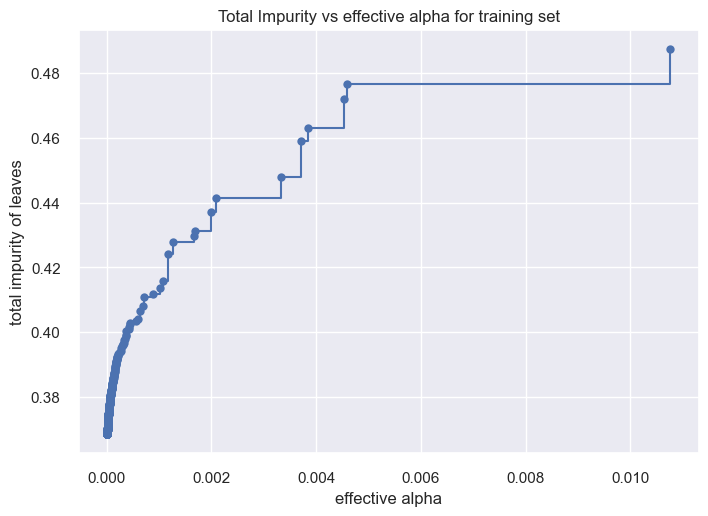

In [441]:
fig, ax = plt.subplots()
ax.plot(ccp_alphas[:-1], impurities[:-1], marker="o", drawstyle="steps-post")
ax.set_xlabel("effective alpha")
ax.set_ylabel("total impurity of leaves")
ax.set_title("Total Impurity vs effective alpha for training set")